## A messy notebook for Retrofitting the csv of the 2023 dataset and creating proper data splits
### Find below:
- renaming columns 
- fixing paths 
- assinging ID's
- fixing video names
- assinging universal time (for splits)
- saving to csv 
- creating a color_map.json 

In [1]:
## load dataframe from csv 

import pandas as pd 
import numpy as np 
import os
import matplotlib.pyplot as plt
from PIL import Image as Image2
import scipy.stats


fname = '/home/lmeyers/ReID_complete/Rafael_splits/summer_2023_v3_all_updated.csv'
dft = pd.read_csv(fname)

#print(np.unique(dft['label']))

dft_sorted = dft.sort_values(by='color_id')

In [8]:
dft.head()
#print(dft['filename'][0])

,img_number,color_id,frame,track,batch,pass,environment,bee_range,filename,background,reID
0,0,white-yellow,831,4,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,white,33
1,1,white-yellow,903,4,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,white,33
2,2,white-yellow,1129,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33
3,3,white-yellow,1145,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33
4,4,white-yellow,1155,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33


In [14]:
color_opts = []
for id in np.unique(dft['color_id']):
    color_opts.append(id.split('-')[0])
print(np.unique(color_opts))
#print(dft.columns)


['blue' 'green' 'lillac' 'orange' 'pink' 'red' 'white' 'yellow']


In [7]:
# 0. Fix filepaths 

dft.rename(columns={'filepath': 'filename'}, inplace=True)
#dft['filename'] = '/home/gsantiago/summer_bee_data/summer_bee_data/'+ dft['filename']
for i in range(len(dft['filename'])):
    dft['filename'][i] = '/home/gsantiago/summer_bee_data/summer_bee_data/'+ dft['filename'][i][2:]

/tmp/ipykernel_36339/2201988501.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft['filename'][i] = '/home/gsantiago/summer_bee_data/summer_bee_data/'+ dft['filename'][i][2:]
/tmp/ipykernel_36339/2201988501.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft['filename'][i] = '/home/gsantiago/summer_bee_data/summer_bee_data/'+ dft['filename'][i][2:]
/tmp/ipykernel_36339/2201988501.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-co

/tmp/ipykernel_36339/2201988501.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft['filename'][i] = '/home/gsantiago/summer_bee_data/summer_bee_data/'+ dft['filename'][i][2:]
/tmp/ipykernel_36339/2201988501.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft['filename'][i] = '/home/gsantiago/summer_bee_data/summer_bee_data/'+ dft['filename'][i][2:]
/tmp/ipykernel_36339/2201988501.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-co

In [6]:
# function to obtain the four corner pixels of each image
def get_corner_pixels(fnames, show_images=True):
    if show_images:
        plt.figure(figsize=(20,15))
    corner_pixels = []
    for k in range(fnames.shape[0]):
        img = np.array(Image2.open(fnames[k]))
        entry = [img[0,0,:], img[-1,0,:], img[0,-1,:], img[-1,-1,:]]
        corner_pixels.append(entry)
        if show_images:
            plt.subplot(5,len(fnames)//5,k+1)
            plt.imshow(img)
    if show_images:
        plt.show()
    return np.array(corner_pixels)

def predict_background(kmeans, corner_pixels):
    predictions = np.zeros(corner_pixels.shape[0])
    for k, element in enumerate(corner_pixels):
        temp = kmeans.predict(corner_pixels[k])
        mask = temp != 0
        pred = scipy.stats.mode(temp[mask])
        #print(pred[1], len(temp[mask]))
        if len(pred[0]) > 0 and pred[1] > 0.5*len(temp[mask]):
            predictions[k] = pred[0][0]
    return predictions

def display_samples(samples, N_sample=50):
    plt.figure(figsize=(20,10))
    for k in range(N_sample):
        img = Image2.open(samples[k])
        #img = img.crop([w_range[0], h_range[0], w_range[1], h_range[1]])
        plt.subplot(5,10,k+1)
        plt.imshow(img)
    plt.show()

In [11]:
#dft['ID'] = dft.groupby(['color_id', 'batch', 'bee_range']).ngroup()

print(np.unique(dft['reID']))

"""
for id in np.unique(dft['ID']):
    print(id)
    display_samples(list(dft[dft['ID']==id]['filename']),)
"""                  

[  1   2   3   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19
  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37
  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127
 128]


"\nfor id in np.unique(dft['ID']):\n    print(id)\n    display_samples(list(dft[dft['ID']==id]['filename']),)\n"

In [ ]:
#replace color code numbers with color_id_strings 




### Some tools to visualize the structure of the data and distributions

In [13]:
N_sample = 50
#print(dft.columns)
print('Num color codes:',len(np.unique(dft['color_id'])))


for color in np.unique(dft['color_id']):
    print('For color code', color,":")
    for column in [dft.columns[3],dft.columns[4],dft.columns[6],dft.columns[7],dft.columns[10]]:
        uniques = np.unique(dft[dft['color_id']==color][column])
        print('    Unique Vals in',column,':',uniques)
        if column == 'batch':
            for batch in uniques:
                print('     For batch',batch)
                filtered = dft[(dft['color_id']==color) & (dft['batch']==batch)]
                for col in [dft.columns[0],dft.columns[3],dft.columns[6],dft.columns[7]]:
                    u_filtered  = np.unique(filtered[col])
                    if col == 'img_number':
                        print('         Imgs in this batch',len(u_filtered))
                    else: 
                        print('         Unique val in',col,':',u_filtered)
                    if col == 'environment':
                        for e in u_filtered:
                            extra_filtered = dft[(dft['color_id']==color) & (dft['batch']==batch) & (dft['environment']==e)]
                            print('                 In enviroment',e,'bees were shown in passes',np.unique(extra_filtered['pass']))

                
        



"""
sample = colors[colors['batch']=='0']
print(len(sample))
print(np.unique(sample['environment']))
#samples = dft[dft['color_id']=='blue'].sample(N_sample).filename.values
#display_samples(samples, N_sample)
"""


Num color codes: 64
For color code blue-blue :
    Unique Vals in track : [ 83 112 114 116 121 122 162 163 166 171 175 181 186 193 196 197]
    Unique Vals in batch : [1 2]
     For batch 1
         Imgs in this batch 84
         Unique val in track : [112 114 116 121 122 193 196 197]
         Unique val in environment : ['in-lab' 'outside']
                 In enviroment in-lab bees were shown in passes [nan]
                 In enviroment outside bees were shown in passes [2.]
         Unique val in bee_range : ['1-32']
     For batch 2
         Imgs in this batch 57
         Unique val in track : [ 83 162 163 166 171 175 181 186]
         Unique val in environment : ['in-lab' 'outside']
                 In enviroment in-lab bees were shown in passes [nan]
                 In enviroment outside bees were shown in passes [2.]
         Unique val in bee_range : ['65-96']
    Unique Vals in environment : ['in-lab' 'outside']
    Unique Vals in bee_range : ['1-32' '65-96']
    Unique Val

"\nsample = colors[colors['batch']=='0']\nprint(len(sample))\nprint(np.unique(sample['environment']))\n#samples = dft[dft['color_id']=='blue'].sample(N_sample).filename.values\n#display_samples(samples, N_sample)\n"

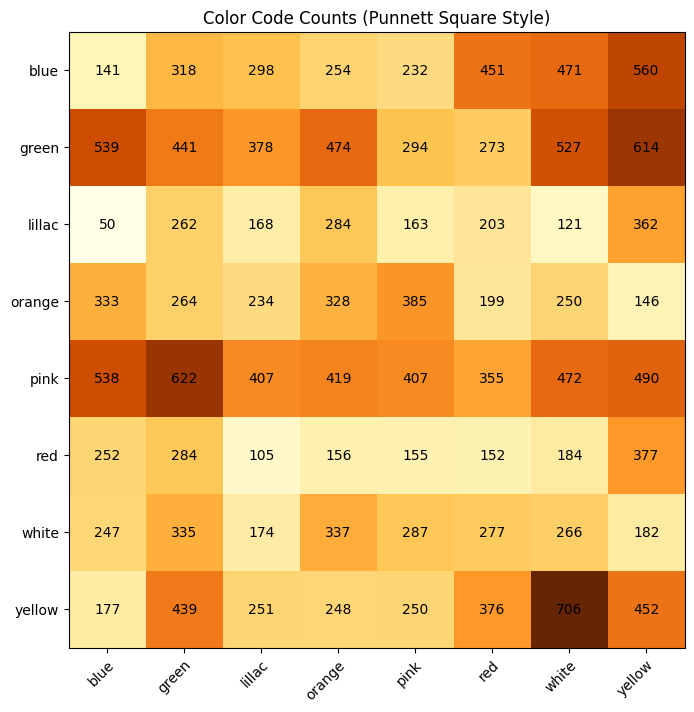

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np


### make a heatmap of which id's have the most images 
def create_punnett_square(df):
    # Extract the color codes from the DataFrame
    color_codes = df['color_id'].tolist()
    
    # Define the possible colors
    possible_colors = ['blue','green','lillac','orange','pink','red','white','yellow']
    
    # Create a matrix to store counts
    counts_matrix = np.zeros((len(possible_colors), len(possible_colors)), dtype=int)
    
    # Count occurrences of each color code
    for code in color_codes:
        colors = code.split('-')
        if len(colors) == 2 and colors[0] in possible_colors and colors[1] in possible_colors:
            row = possible_colors.index(colors[0])
            col = possible_colors.index(colors[1])
            counts_matrix[row][col] += 1
    
    # Create a heatmap of the counts
    fig, ax = plt.subplots(figsize=(8, 8))
    im = ax.imshow(counts_matrix, cmap='YlOrBr')

    # Set axis labels and ticks
    ax.set_xticks(np.arange(len(possible_colors)))
    ax.set_yticks(np.arange(len(possible_colors)))
    ax.set_xticklabels(possible_colors)
    ax.set_yticklabels(possible_colors)
    
    # Rotate the tick labels and set their alignment
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
    
    # Display the counts in each cell
    for i in range(len(possible_colors)):
        for j in range(len(possible_colors)):
            text = ax.text(j, i, counts_matrix[i, j], ha="center", va="center", color="black")
    
    # Set a title
    ax.set_title("Color Code Counts (Punnett Square Style)")

    # Show the heatmap
    plt.show()

# Example usage:
# Assuming you have a DataFrame 'image_df' with a 'color-code' column
create_punnett_square(dft)


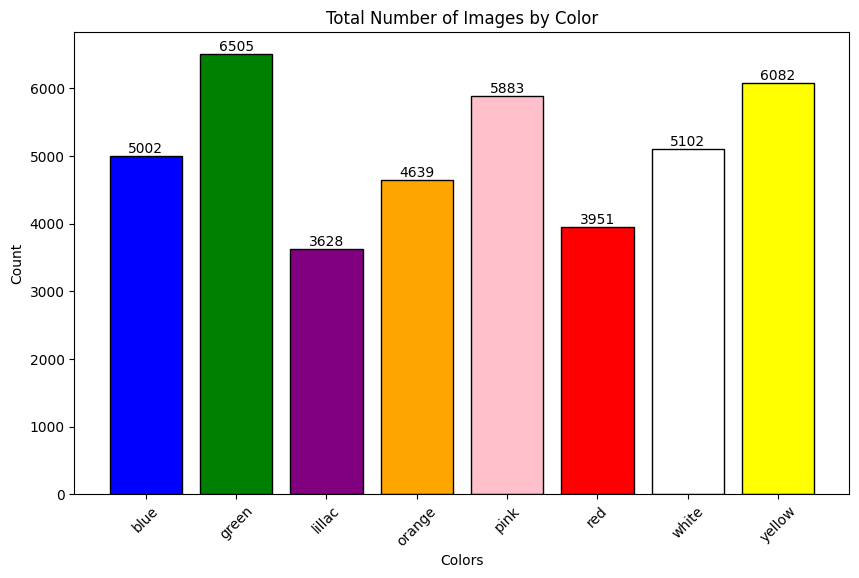

In [26]:

def create_color_count_bar_graph(df):
    # Define the possible colors
    possible_colors = ['blue','green','lillac','orange','pink','red','white','yellow']
    
    # Create a dictionary to store the counts
    color_counts = {color: 0 for color in possible_colors}
    
    # Extract the color codes from the DataFrame and count occurrences
    color_codes = df['color_id'].tolist()
    for code in color_codes:
        colors = code.split('-')
        if len(colors) == 2 and colors[0] in possible_colors and colors[1] in possible_colors:
            for color in colors:
                color_counts[color] += 1
    
    # Sort the counts by color
    sorted_color_counts = dict(sorted(color_counts.items()))
    
    bar_colors = sorted_color_counts.keys()
    bar_colors = [x if x != 'lillac' else 'purple' for x in bar_colors] #replace lavender
    # Create a bar graph
    plt.figure(figsize=(10, 6))
    plt.bar(sorted_color_counts.keys(), sorted_color_counts.values(), color=bar_colors,edgecolor = 'black')
    
    for i, count in enumerate(sorted_color_counts.values()):
        plt.text(i, count + 1, str(count), ha='center', va='bottom')

    # Label the axes and set a title
    plt.xlabel("Colors")
    plt.ylabel("Count")
    plt.title("Total Number of Images by Color")
 
    # Show the bar graph
    plt.xticks(rotation=45)
    plt.show()

# Example usage:
# Assuming you have a DataFrame 'image_df' with a 'color-code' column
create_color_count_bar_graph(dft)


### Clean up dataframe to use Rafael's datasplitter

In [ ]:
## 1. Assign video name column based on names of images 
dft['video_original_name'] = 0 
for i in range(len(dft['filename'])):
   dft['video_original_name'][i] = os.path.basename(dft['filename'][i][:-28])
   print(os.path.basename(dft['filename'][i][:-28]))

In [ ]:
# 2. Assign random video number becuase names do not contain info about order filmed 
dft['Video_num'] = dft.groupby(['video_original_name']).ngroup()
print(np.unique(dft['Video_num']))


In [31]:
# 3. Assign flowerpatch style name to be auto parsed
dft['video_flowerpatch_name_construct'] = 0 
for i in range(len(dft['filename'])):
    dft['video_flowerpatch_name_construct'][i] = 'f'+str(dft['Video_num'][i])+'x2023_07_19.mp4'
print(np.unique(dft['video_flowerpatch_name_construct']))


/tmp/ipykernel_36339/408858156.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dft['video_flowerpatch_name_construct'][i] = 'f'+str(dft['Video_num'][i])+'x2023_07_19.mp4'


['f0x2023_07_19.mp4' 'f1x2023_07_19.mp4' 'f2x2023_07_19.mp4'
 'f3x2023_07_19.mp4' 'f4x2023_07_19.mp4' 'f5x2023_07_19.mp4'
 'f6x2023_07_19.mp4' 'f7x2023_07_19.mp4' 'f8x2023_07_19.mp4']
Index(['img_number', 'color_id', 'frame', 'track', 'batch', 'pass',
       'environment', 'bee_range', 'filename', 'background', 'reID',
       'video_original_name', 'Video_num', 'video_flowerpatch_name_construct'],
      dtype='object')


In [37]:
#print columns to show current state of dataframe
print(dft.columns)

Index(['img_number', 'color_id', 'frame', 'track', 'batch', 'pass',
       'environment', 'bee_range', 'filename', 'background', 'ID',
       'video_original_name', 'Video_num', 'video_flowerpatch_name_construct',
       'video', 'uniform_time', 'color_num'],
      dtype='object')


In [33]:
from my_bees_reid_dataset import * 

## 4. Create standardized video name (for Rafaels code)

dft['video'] = dft['video_flowerpatch_name_construct'].apply(lambda x: generate_video_id(x))
dft.head()

,img_number,color_id,frame,track,batch,pass,environment,bee_range,filename,background,reID,video_original_name,Video_num,video_flowerpatch_name_construct,video
0,0,white-yellow,831,4,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,white,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00
1,1,white-yellow,903,4,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,white,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00
2,2,white-yellow,1129,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00
3,3,white-yellow,1145,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00
4,4,white-yellow,1155,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00


In [38]:
## 5. Assign uniform time to link all images in time based on vid number and frame
#--- semi arbritrary in case of Summer 2023 data where we don't know order of filming videos

#dft = assign_universal_time(dft,'video','frame')
dft.head()

,img_number,color_id,frame,track,batch,pass,environment,bee_range,filename,background,ID,video_original_name,Video_num,video_flowerpatch_name_construct,video,uniform_time,color_num
0,0,white-yellow,831,4,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,white,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00,2000831,55
1,1,white-yellow,903,4,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,white,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00,2000903,55
2,2,white-yellow,1129,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00,2001129,55
3,3,white-yellow,1145,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00,2001145,55
4,4,white-yellow,1155,5,1,NaN,in-lab,33-64,/home/gsantiago/summer_bee_data/summer_bee_dat...,blue,33,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,f1x2023_07_19.mp4,2023_07_19_f01.00,2001155,55


In [35]:
# 6. Replace some column names
dft.rename(columns={'reID': 'ID'}, inplace=True)

In [36]:
# 7. Add num to describe color code
dft['color_num'] = 0 
dft['color_num'] = dft.groupby(['color_id']).ngroup()

In [39]:
##move columns into expected order
dft = dft[['ID','color_num','video','video_original_name','img_number', 'color_id', 'track', 'frame','uniform_time', 'batch', 'pass',
       'environment', 'bee_range','background','Video_num',
        'video_flowerpatch_name_construct', 'filename',
       ]]

# dft = dft[['ID','video','video_orig','track','frame','uniform_time','dir','filename']]


In [40]:
## save updated df to csv 
import csv 

#dft.to_csv('summer_2023__v3_all_updated.csv')

### Checking saved CSV

In [8]:
fname = '/home/lmeyers/ReID_complete/summer_2023_v3_all_updated.csv'
dft = pd.read_csv(fname)
dft.head()


,Unnamed: 0,ID,color_num,video,video_original_name,img_number,color_id,track,frame,uniform_time,batch,pass,environment,bee_range,background,Video_num,video_flowerpatch_name_construct,filename
0,0,33,55,2023_07_19_f01.00,young-adults-blue-white-in-lab-33-64_batch_1.m...,0,white-yellow,4,831,2000831,1,NaN,in-lab,33-64,white,1,f1x2023_07_19.mp4,/home/gsantiago/summer_bee_data/summer_bee_dat...
1,1,33,55,2023_07_19_f01.00,young-adults-blue-white-in-lab-33-64_batch_1.m...,1,white-yellow,4,903,2000903,1,NaN,in-lab,33-64,white,1,f1x2023_07_19.mp4,/home/gsantiago/summer_bee_data/summer_bee_dat...
2,2,33,55,2023_07_19_f01.00,young-adults-blue-white-in-lab-33-64_batch_1.m...,2,white-yellow,5,1129,2001129,1,NaN,in-lab,33-64,blue,1,f1x2023_07_19.mp4,/home/gsantiago/summer_bee_data/summer_bee_dat...
3,3,33,55,2023_07_19_f01.00,young-adults-blue-white-in-lab-33-64_batch_1.m...,3,white-yellow,5,1145,2001145,1,NaN,in-lab,33-64,blue,1,f1x2023_07_19.mp4,/home/gsantiago/summer_bee_data/summer_bee_dat...
4,4,33,55,2023_07_19_f01.00,young-adults-blue-white-in-lab-33-64_batch_1.m...,4,white-yellow,5,1155,2001155,1,NaN,in-lab,33-64,blue,1,f1x2023_07_19.mp4,/home/gsantiago/summer_bee_data/summer_bee_dat...


In [51]:
print('Bee IDs possible:')
print(np.unique(dft['ID']))
print('Total number of IDs',len(np.unique(dft['ID'])))

import random

def display_images_for_color_code(df, color_code):
    # Filter the DataFrame by the specified color code
    filtered_df = df[df['color_id'] == color_code]
    
    # Group the filtered DataFrame by unique IDs
    grouped = filtered_df.groupby('ID')
    
    # Randomly select one image from each ID along with its ID value
    selected_images_and_ids = [(group.sample(1)['Image'].values[0], id) for id, group in grouped]
    
    # Create a subplot to display the images side by side
    num_images = len(selected_images_and_ids)
    fig, axes = plt.subplots(1, num_images, figsize=(12, 4))
    
    for i, (image_path, id_value) in enumerate(selected_images_and_ids):
        img = plt.imread(image_path)
        axes[i].imshow(img)
        axes[i].set_title(f'ID {id_value}')
        axes[i].axis('off')
    
    plt.show()

for num in np.unique(dft['color_id']):
    print('Color_id',num,'contains IDs:',np.unique(dft[dft['color_id']==num]['ID']))
    display_images_for_color_code(dft, num)

Bee IDs possible:
[  1   2   3   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19
  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37
  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127
 128]
Total number of IDs 127
Color_id blue-blue contains IDs: [10 74]



KeyboardInterrupt



## Create color map json to use for color detection

In [11]:
codes = np.unique(dft['color_id'])
color_dict = {}
for code in codes:
    #print('Color Code: ',code)
    num = str(np.unique(dft[dft['color_id']==code]['color_num'])[0])
    #print('Color ID Num ',num)
    #print('IDs with this color code',np.unique(dft[dft['color_id']==code]['ID']))
    i = code.find('-')
    if i != -1:
        color1 = code[:i]
        color2 = code[i+1:]
        color_dict[num] = [color1,color2]
    else:
        color_dict[num] = [code,code]

print(color_dict)
all_colors = []
for v in color_dict.values():
    all_colors = np.concatenate((all_colors,v))

print(np.unique(dft['color_id']))
print(np.unique(all_colors))

color_list = ['blue','green','lillac','orange','pink','red','white','yellow']

color_map = {}

for key in color_dict:
    color_map[key]=[list(np.zeros([8])),list(np.zeros([8]))]
    for i, c in enumerate(color_dict[key]):
        print(c)
        color_map[key][i][color_list.index(c)] = 1

import json

print(color_map)
with open("./summer_2023_v3_color_map_w_order.json", 'w') as f:
   #json.dump(color_map,f)
    


{'0': ['blue', 'blue'], '1': ['blue', 'green'], '2': ['blue', 'lillac'], '3': ['blue', 'orange'], '4': ['blue', 'pink'], '5': ['blue', 'red'], '6': ['blue', 'white'], '7': ['blue', 'yellow'], '8': ['green', 'blue'], '9': ['green', 'green'], '10': ['green', 'lillac'], '11': ['green', 'orange'], '12': ['green', 'pink'], '13': ['green', 'red'], '14': ['green', 'white'], '15': ['green', 'yellow'], '16': ['lillac', 'blue'], '17': ['lillac', 'green'], '18': ['lillac', 'lillac'], '19': ['lillac', 'orange'], '20': ['lillac', 'pink'], '21': ['lillac', 'red'], '22': ['lillac', 'white'], '23': ['lillac', 'yellow'], '24': ['orange', 'blue'], '25': ['orange', 'green'], '26': ['orange', 'lillac'], '27': ['orange', 'orange'], '28': ['orange', 'pink'], '29': ['orange', 'red'], '30': ['orange', 'white'], '31': ['orange', 'yellow'], '32': ['pink', 'blue'], '33': ['pink', 'green'], '34': ['pink', 'lillac'], '35': ['pink', 'orange'], '36': ['pink', 'pink'], '37': ['pink', 'red'], '38': ['pink', 'white'], 

#### Create Color Map that uses strings

In [21]:
import json 
dicto = dict(zip(dft['color_num'],dft['color_id']))

file = '/home/lmeyers/ReID_complete/summer_2023_v3_color_map_w_order.json'
with open(file,'r') as f:
    color_map = json.load(f)

print(dicto)

color_map_str = {}

for key in color_map:
    val = color_map[key]
    s = dicto[int(key)]
    color_map_str[s] = val

with open("./summer_2023_v3_color_map_id_string_w_order_.json", 'w') as f:
   json.dump(color_map_str,f)

{55: 'white-yellow', 48: 'white-blue', 49: 'white-green', 52: 'white-pink', 54: 'white-white', 51: 'white-orange', 50: 'white-lillac', 53: 'white-red', 31: 'orange-yellow', 24: 'orange-blue', 25: 'orange-green', 28: 'orange-pink', 30: 'orange-white', 27: 'orange-orange', 26: 'orange-lillac', 29: 'orange-red', 23: 'lillac-yellow', 16: 'lillac-blue', 20: 'lillac-pink', 22: 'lillac-white', 17: 'lillac-green', 19: 'lillac-orange', 18: 'lillac-lillac', 21: 'lillac-red', 47: 'red-yellow', 40: 'red-blue', 41: 'red-green', 44: 'red-pink', 46: 'red-white', 43: 'red-orange', 42: 'red-lillac', 45: 'red-red', 63: 'yellow-yellow', 56: 'yellow-blue', 57: 'yellow-green', 62: 'yellow-white', 59: 'yellow-orange', 58: 'yellow-lillac', 61: 'yellow-red', 7: 'blue-yellow', 0: 'blue-blue', 1: 'blue-green', 4: 'blue-pink', 6: 'blue-white', 3: 'blue-orange', 2: 'blue-lillac', 5: 'blue-red', 15: 'green-yellow', 8: 'green-blue', 9: 'green-green', 12: 'green-pink', 14: 'green-white', 11: 'green-orange', 10: 'gre

## Adding color num to Gabriel's splits

In [2]:
color_2_num = dict(zip(dft['color_id'],dft['color_num'],))
print(color_2_num)

{'white-yellow': 55, 'white-blue': 48, 'white-green': 49, 'white-pink': 52, 'white-white': 54, 'white-orange': 51, 'white-lillac': 50, 'white-red': 53, 'orange-yellow': 31, 'orange-blue': 24, 'orange-green': 25, 'orange-pink': 28, 'orange-white': 30, 'orange-orange': 27, 'orange-lillac': 26, 'orange-red': 29, 'lillac-yellow': 23, 'lillac-blue': 16, 'lillac-pink': 20, 'lillac-white': 22, 'lillac-green': 17, 'lillac-orange': 19, 'lillac-lillac': 18, 'lillac-red': 21, 'red-yellow': 47, 'red-blue': 40, 'red-green': 41, 'red-pink': 44, 'red-white': 46, 'red-orange': 43, 'red-lillac': 42, 'red-red': 45, 'yellow-yellow': 63, 'yellow-blue': 56, 'yellow-green': 57, 'yellow-white': 62, 'yellow-orange': 59, 'yellow-lillac': 58, 'yellow-red': 61, 'blue-yellow': 7, 'blue-blue': 0, 'blue-green': 1, 'blue-pink': 4, 'blue-white': 6, 'blue-orange': 3, 'blue-lillac': 2, 'blue-red': 5, 'green-yellow': 15, 'green-blue': 8, 'green-green': 9, 'green-pink': 12, 'green-white': 14, 'green-orange': 11, 'green-l

In [4]:
import os

#test_df = pd.DataFrame(dft['color_id'])
#test_df['color_num'] = dft['color_id'].map(color_2_num)
def add_color_num(filename):
    '''add color_num column to csv based on mapping of color_id
    from filename (str) path to csv '''
    file = filename #put name of csv here 
    data = pd.read_csv(file)

    data['color_num'] = data['color_id'].map(color_2_num)
    data.to_csv(file)

# Known directory
base_directory = '/home/gsantiago/summer_bee_data/open_sets/'

# Search string to match subdirectories
search_string = 'open'

# Walk through the base directory
for root, dirs, files in os.walk(base_directory):
    for directory in dirs:
        if search_string in directory:
            sub_directory = os.path.join(root, directory)
            print(f"Processing files in subdirectory: {sub_directory}")
            for file in os.listdir(sub_directory):
                file_path = os.path.join(sub_directory, file)
                add_color_num(file_path)



Processing files in subdirectory: /home/gsantiago/summer_bee_data/open_sets/new_open_08_ids_monocolor_batch2
Processing files in subdirectory: /home/gsantiago/summer_bee_data/open_sets/new_open_08_ids_double_colors_batch2
Processing files in subdirectory: /home/gsantiago/summer_bee_data/open_sets/new_open_32_ids_permutated_ids_batch1
Processing files in subdirectory: /home/gsantiago/summer_bee_data/open_sets/new_open_16_ids_four_times_permutated_code_colors_batch1
Processing files in subdirectory: /home/gsantiago/summer_bee_data/open_sets/open_8_ids_double_color_batch1
Processing files in subdirectory: /home/gsantiago/summer_bee_data/open_sets/open_4_ids_all_colors_batch1
Processing files in subdirectory: /home/gsantiago/summer_bee_data/open_sets/new_open_24_ids_monocolor_and_non_permutated_ids_batch2
Processing files in subdirectory: /home/gsantiago/summer_bee_data/open_sets/new_open_16_ids_four_times_non_permutated_code_colors_batch1
Processing files in subdirectory: /home/gsantiago/

In [28]:
test_df.head()

,color_id,color_num
0,white-yellow,55
1,white-yellow,55
2,white-yellow,55
3,white-yellow,55
4,white-yellow,55


## Perform Datasplits

In [56]:
# make sure to update the yml file first 

!python split_dataset.py summer_datasplit_config.yml 

#### Validate types of splits by anlyzing csv files

In [58]:
test_ld_ti_ts = pd.read_csv('/home/lmeyers/ReID_complete/summer_2023_reid_testll_updated_labelDependent_trackDependent_timeSorted.csv')
train_ld_ti_ts = pd.read_csv('/home/lmeyers/ReID_complete/summer_2023_reid_trainll_updated_labelDependent_trackDependent_timeSorted.csv')

print('ids in train set',list(np.unique(train_ld_ti_ts['ID'])))
print("ids in test set",list(np.unique(test_ld_ti_ts['ID'])))

counts = train_ld_ti_ts['ID'].value_counts()
print('Num per ID in train',counts)

counts = test_ld_ti_ts['ID'].value_counts()
print('Num per ID_ in test',counts)


ids in train set [1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128]
ids in test set [1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 11

## Adding Mask paths to the csv

In [38]:
test = pd.read_csv('multicolor_test_all_updated_labelDependent_trackIndependent_timeSorted.csv')
train = pd.read_csv('multicolor_train_all_updated_labelDependent_trackIndependent_timeSorted.csv')
valid = pd.read_csv('/home/lmeyers/ReID_complete/multicolor_valid_all_updated_labelDependent_trackIndependent_timeSorted.csv')

mask_dir = '/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/'

walk = os.walk(mask_dir)

all_files = []
for root, dir, files in walk:
    for f in files:
        all_files.append(root+r'/'+f)

valid['mask_filename'] = 0

for i in range(len(valid['filename'])):
    valid['mask_filename'][i] = [value for index, value in enumerate(all_files) if valid['filename'][i][60:-4] in value].pop()


/tmp/ipykernel_40757/772076005.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  valid['mask_filename'][i] = [value for index, value in enumerate(all_files) if valid['filename'][i][60:-4] in value].pop()


In [39]:
# Display to check and then write to csv 
valid.head()

with open('/home/lmeyers/ReID_complete/multicolor_valid_all_updated_labelDependent_trackIndependent_timeSorted.csv','w') as f:
    test.to_csv(f)

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0605RedWhite/


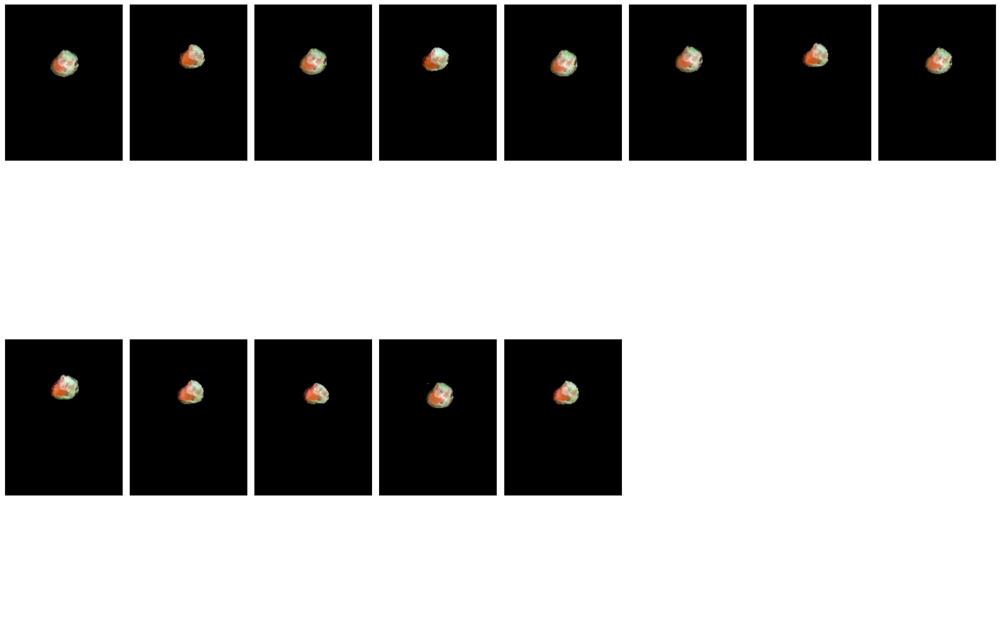

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1905YelloGreen/


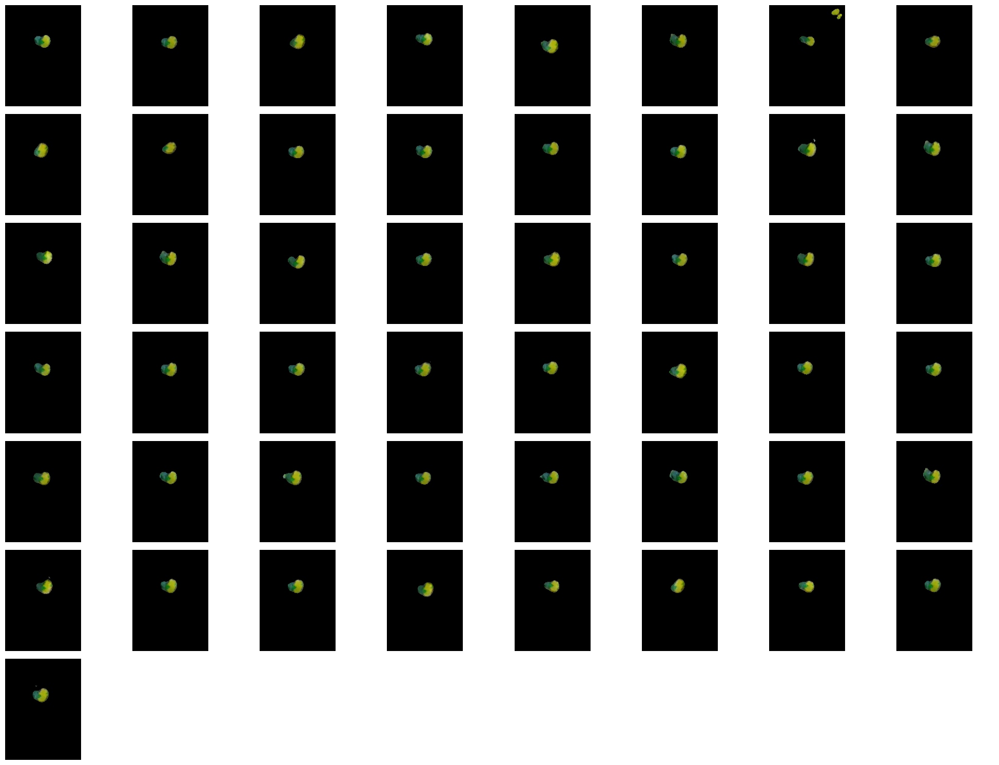

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1702RedWhite/


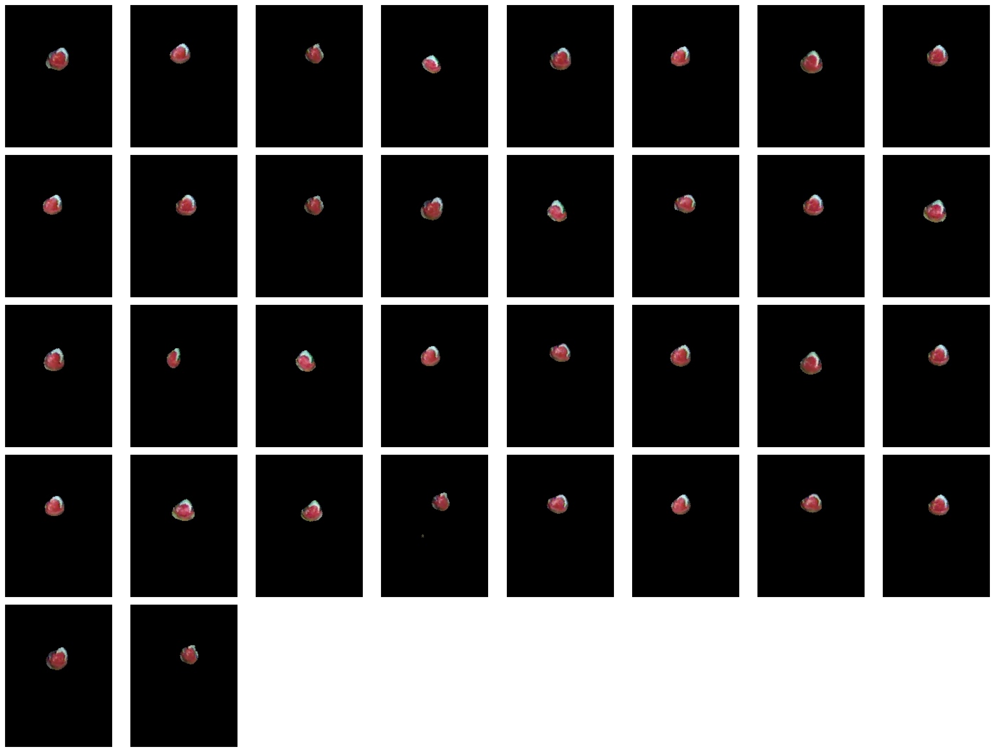

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2202BlueLightBlue/


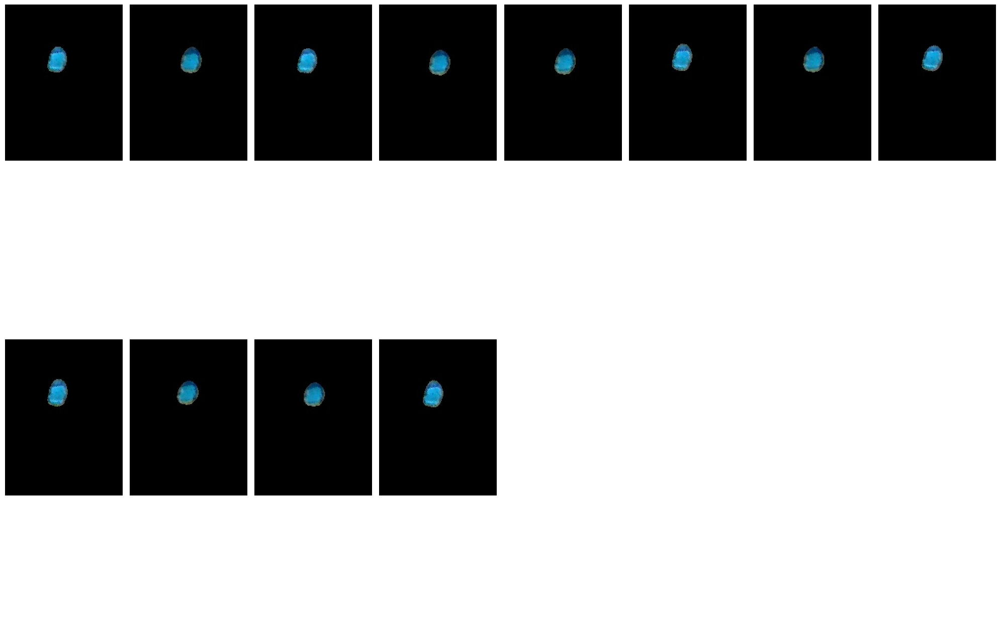

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2105YellowBlue/


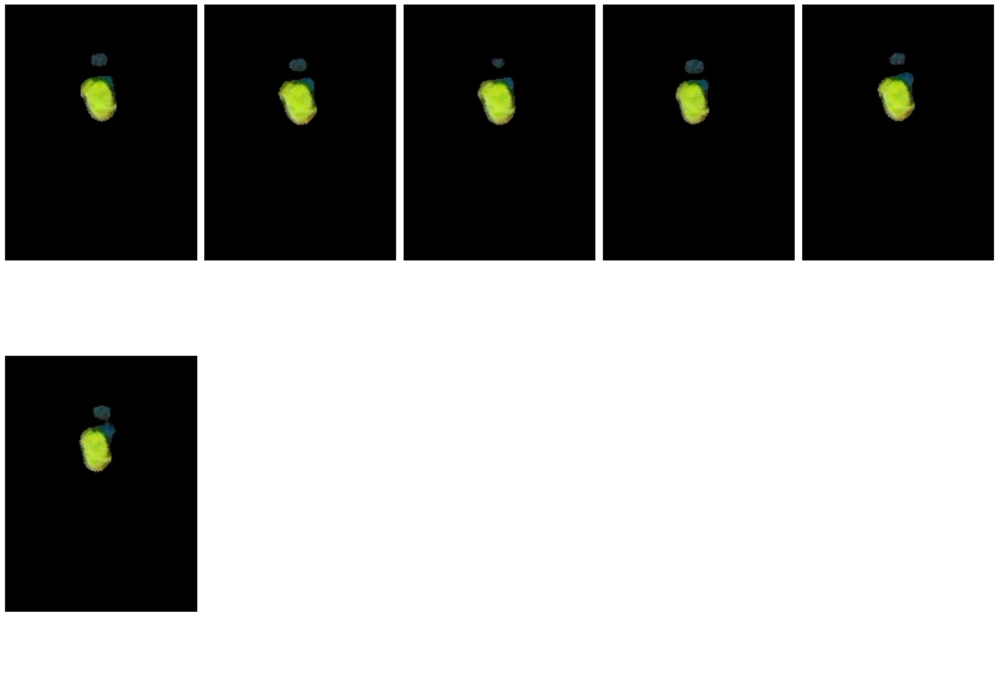

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2106PurpleBlue/


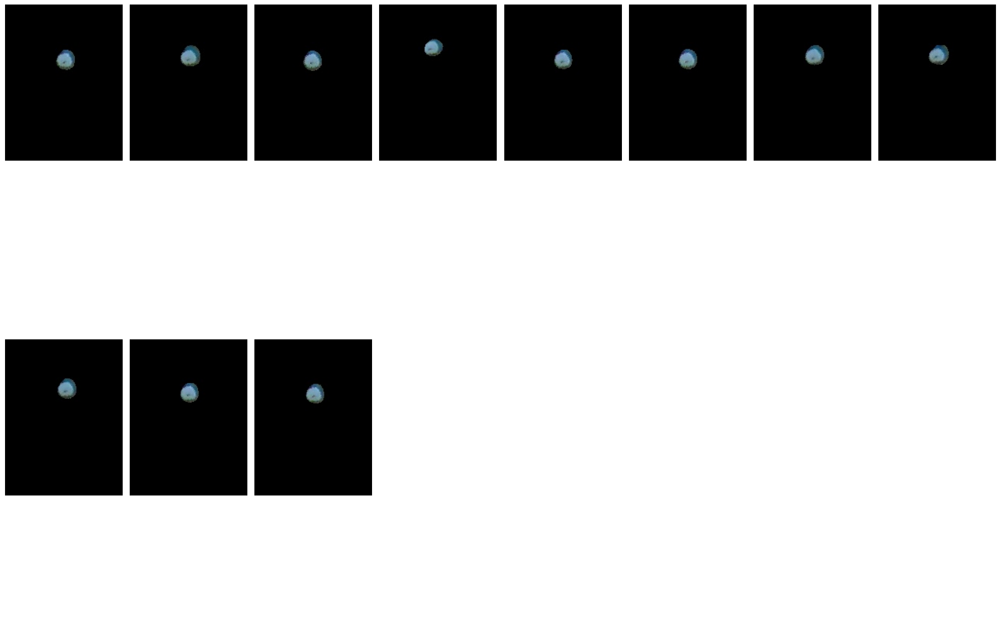

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1902YellowGrey/


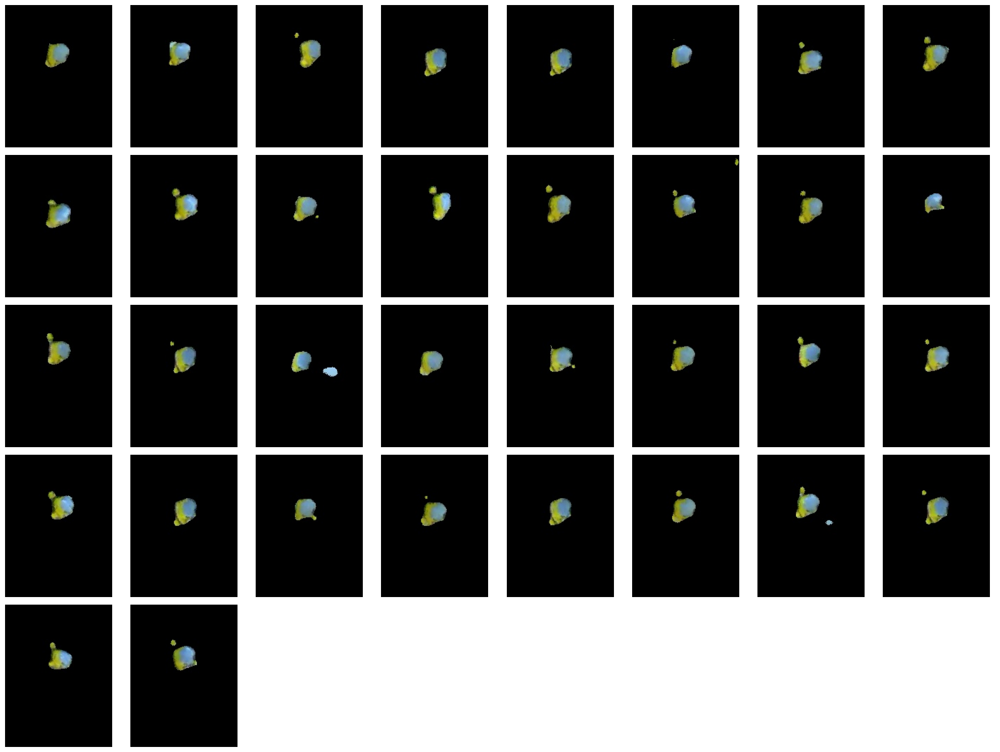

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1706WhiteSilver/


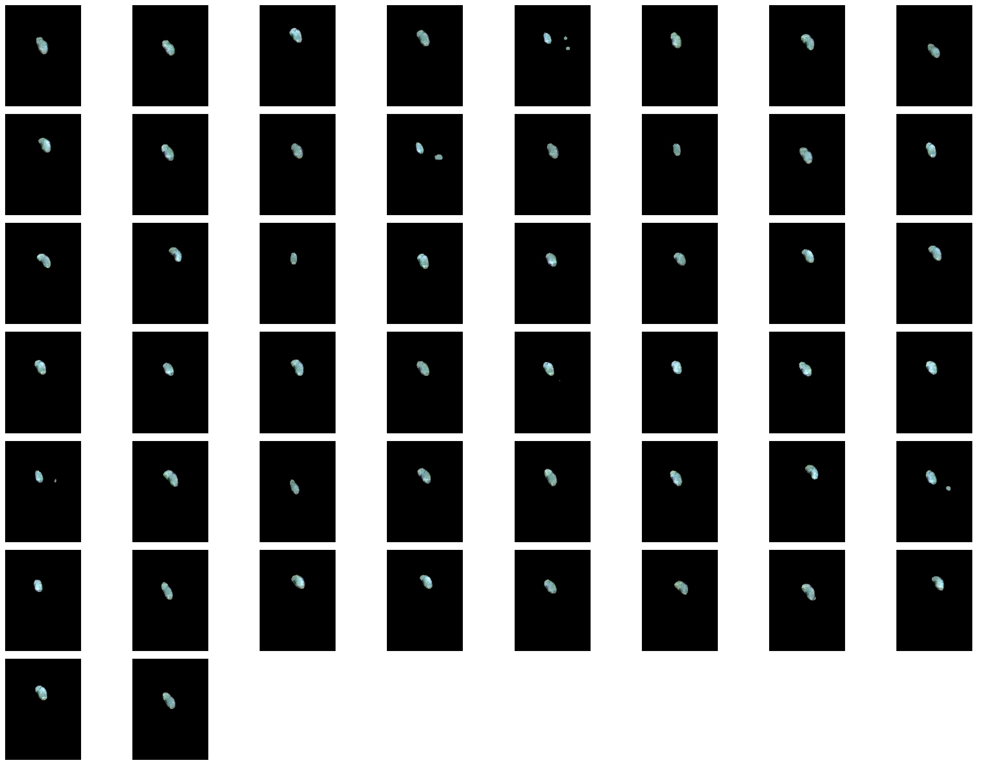

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0602YellowPink/


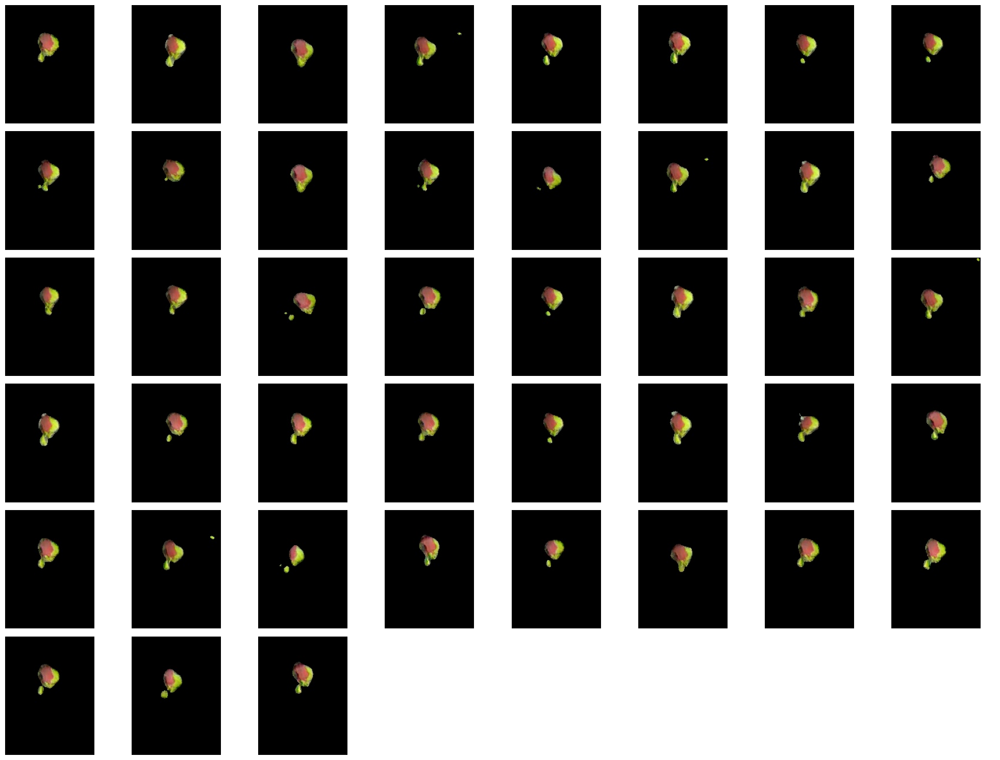

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2204GreenGray/


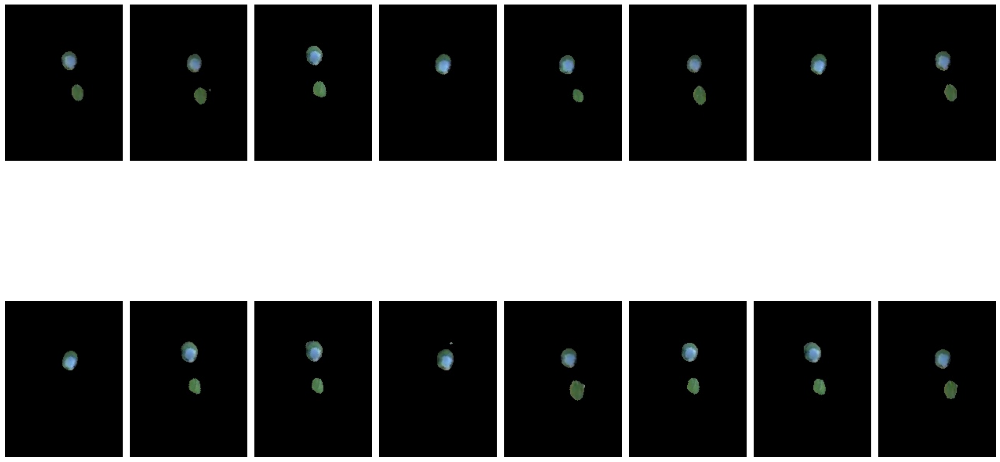

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1004GreenPinkHead/


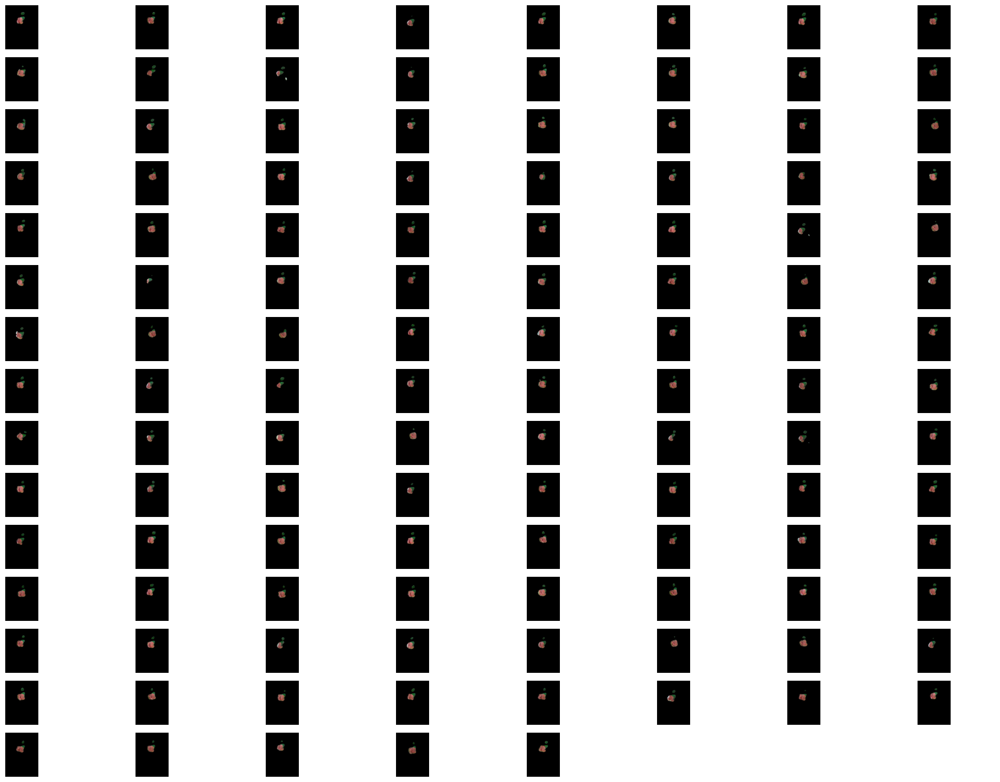

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1906RedYellow/


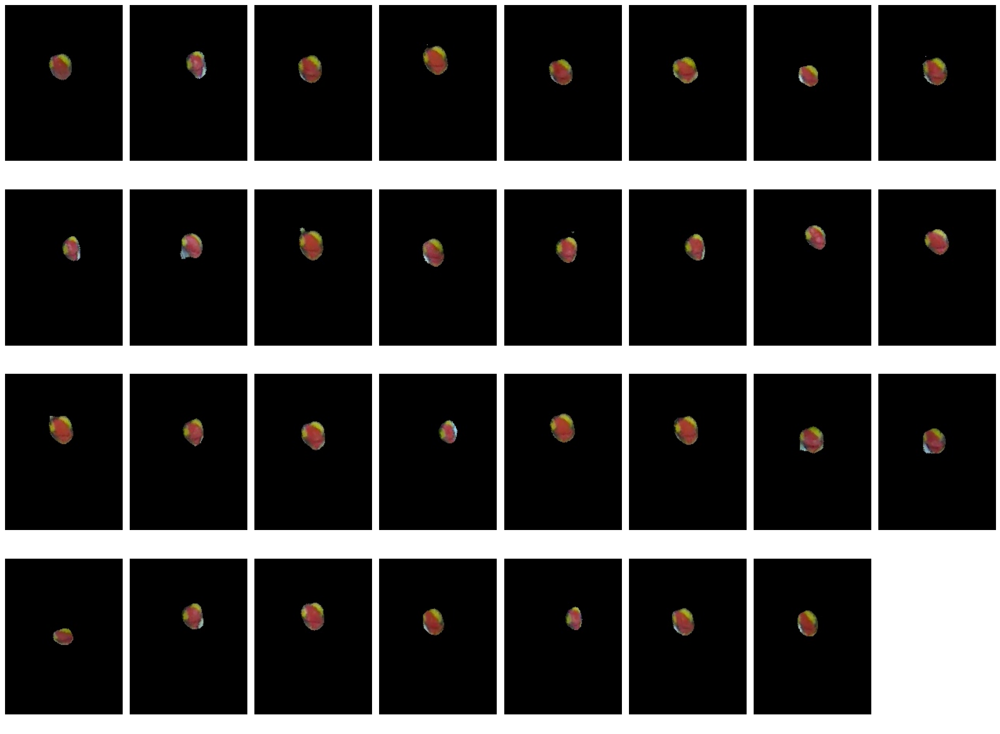

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2201Blue/


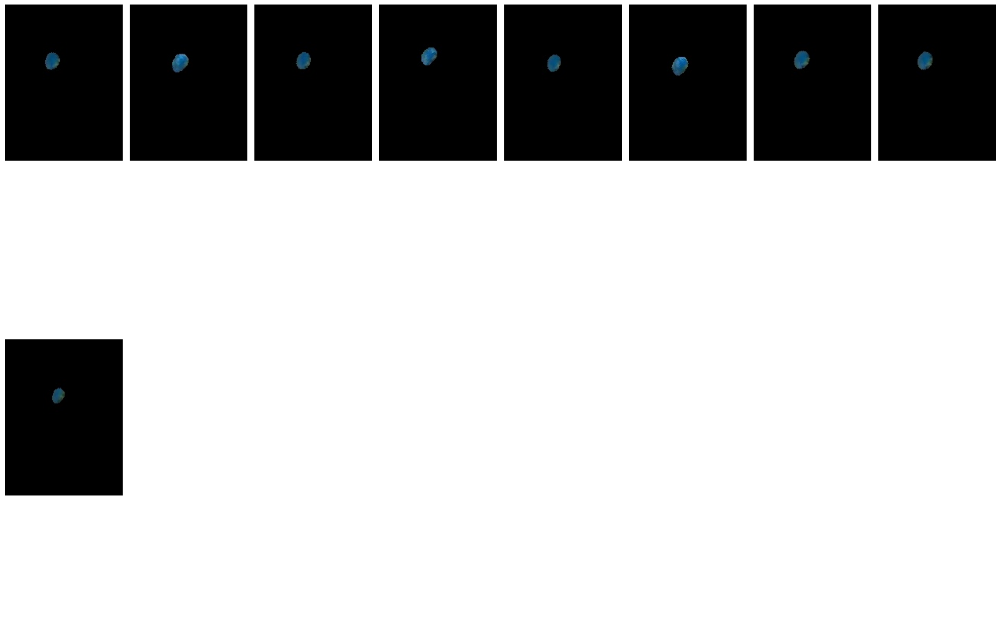

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1707YellowWhite/


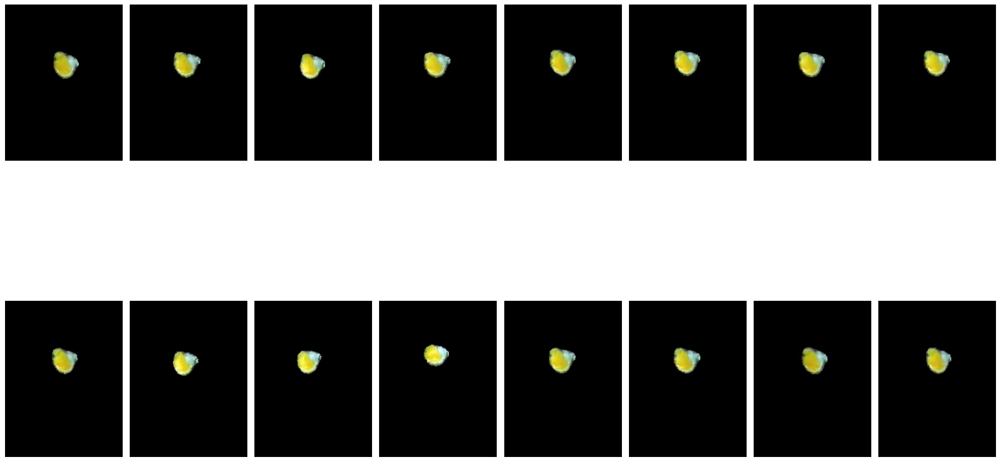

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2208YelloThorGreen/


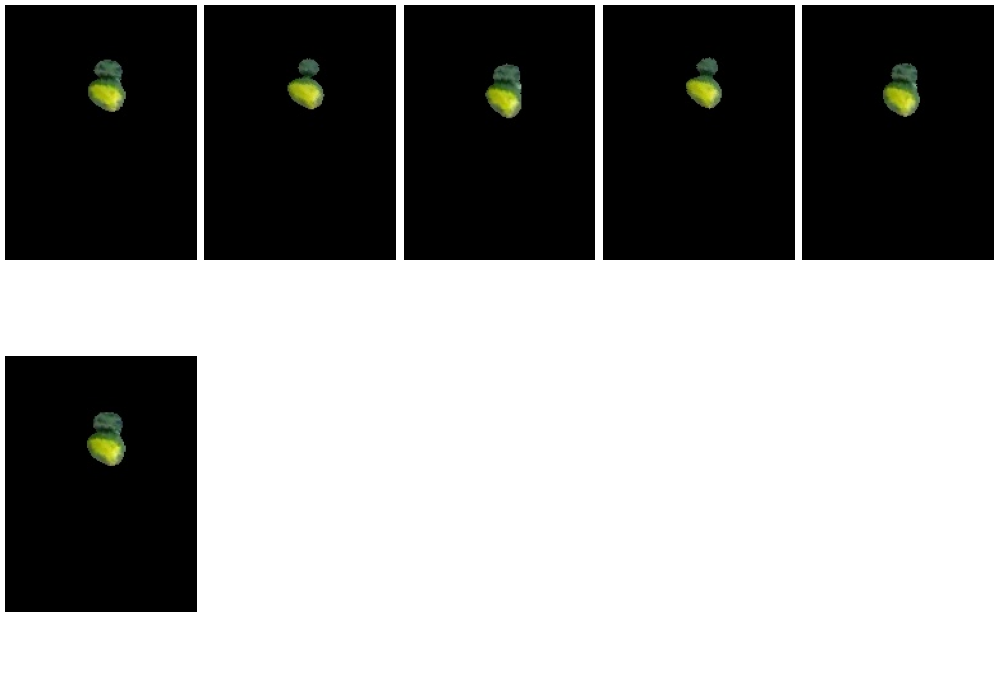

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1307GreenLightBlue/


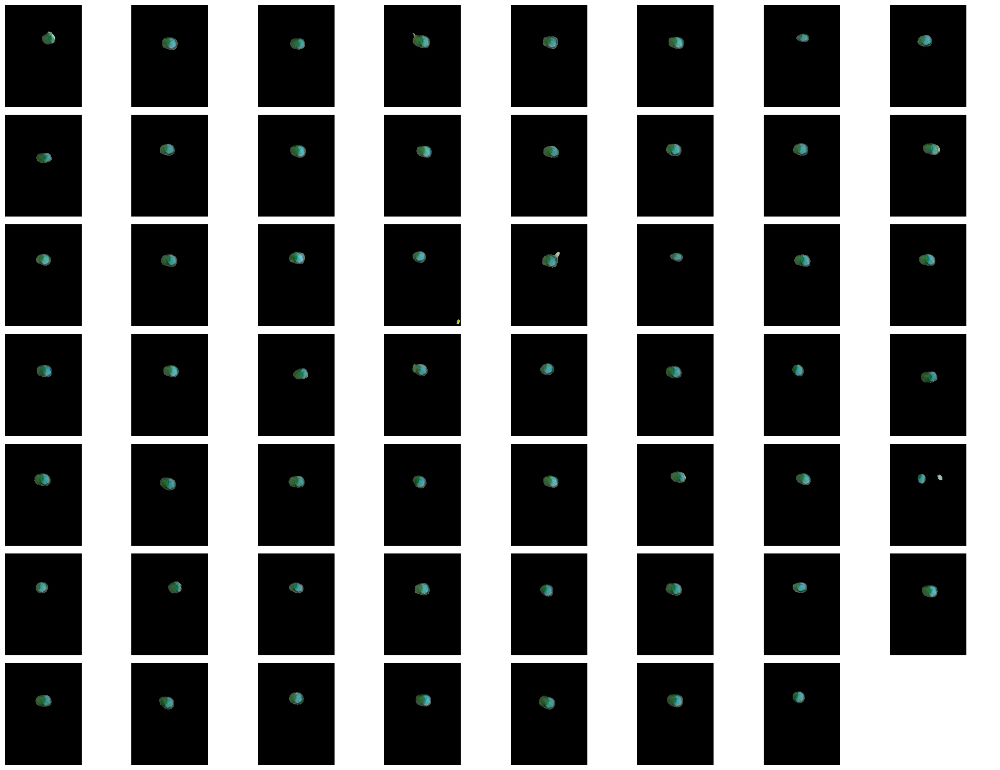

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2203Green/


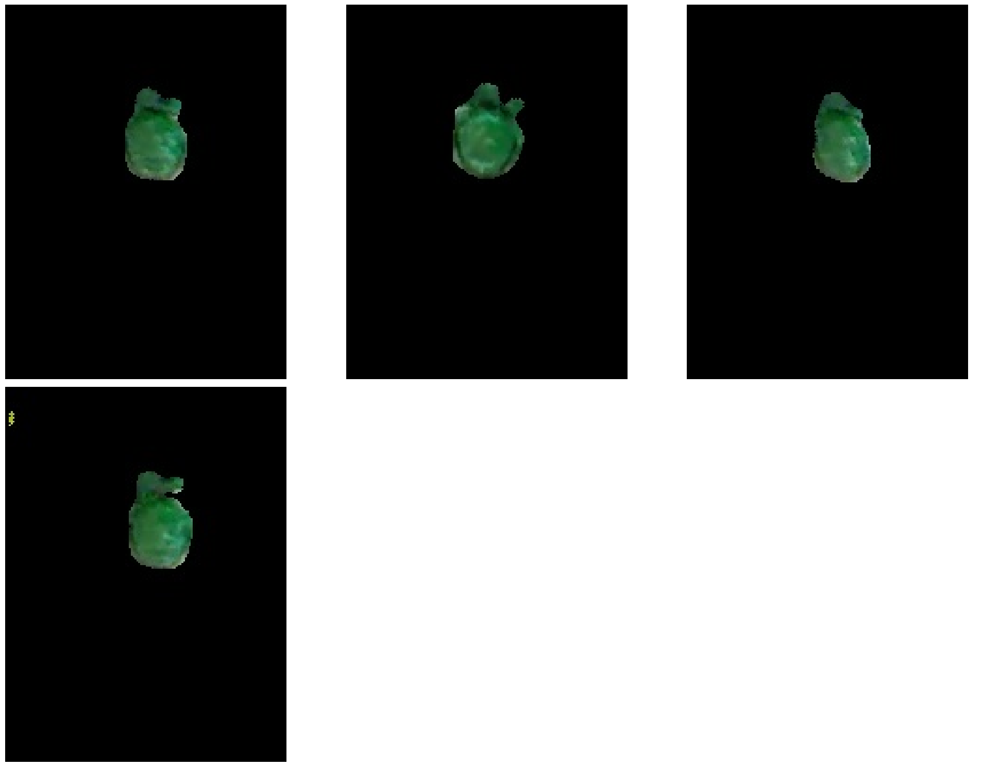

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0805DarkRedYellow/


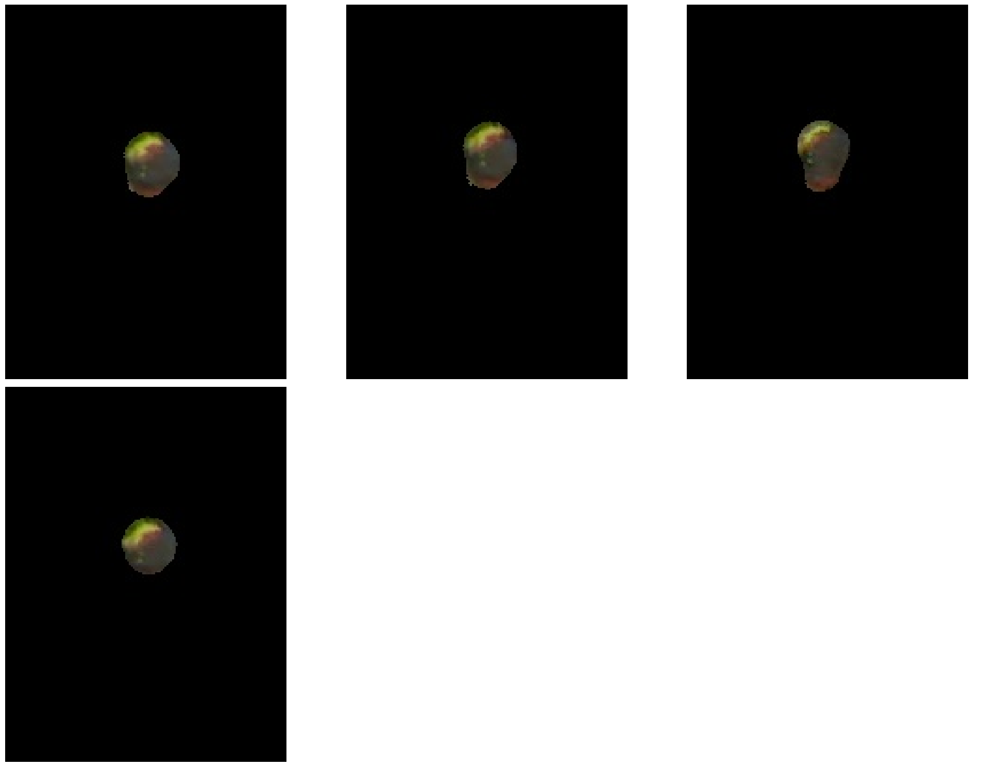

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1005Green/


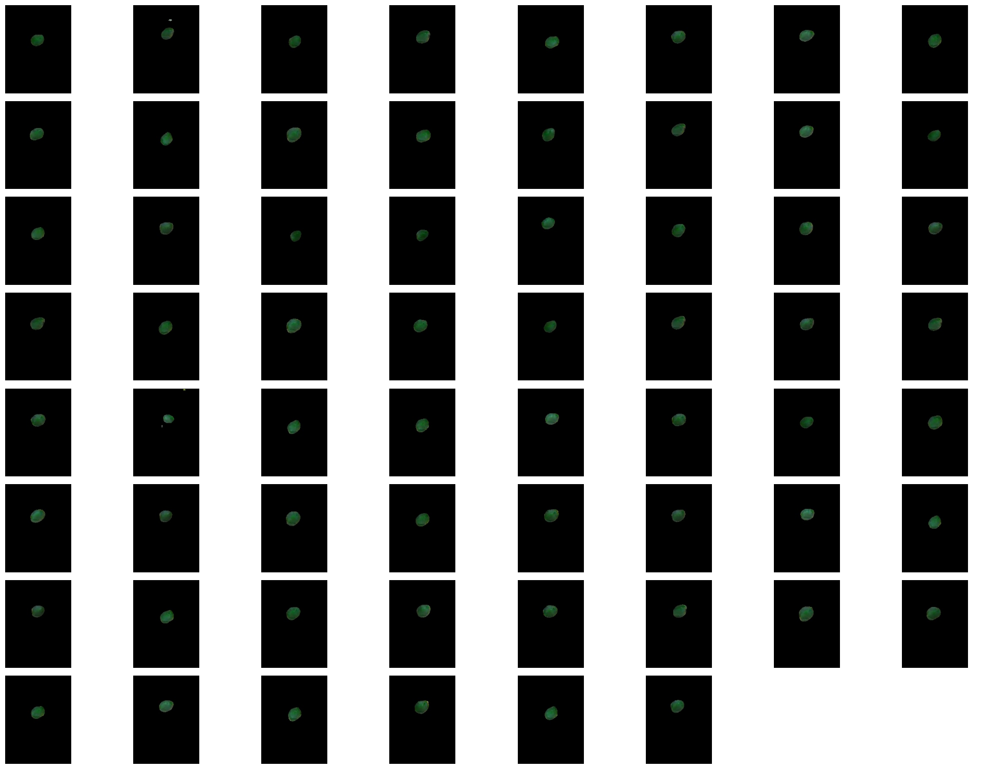

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1904BlueYello/


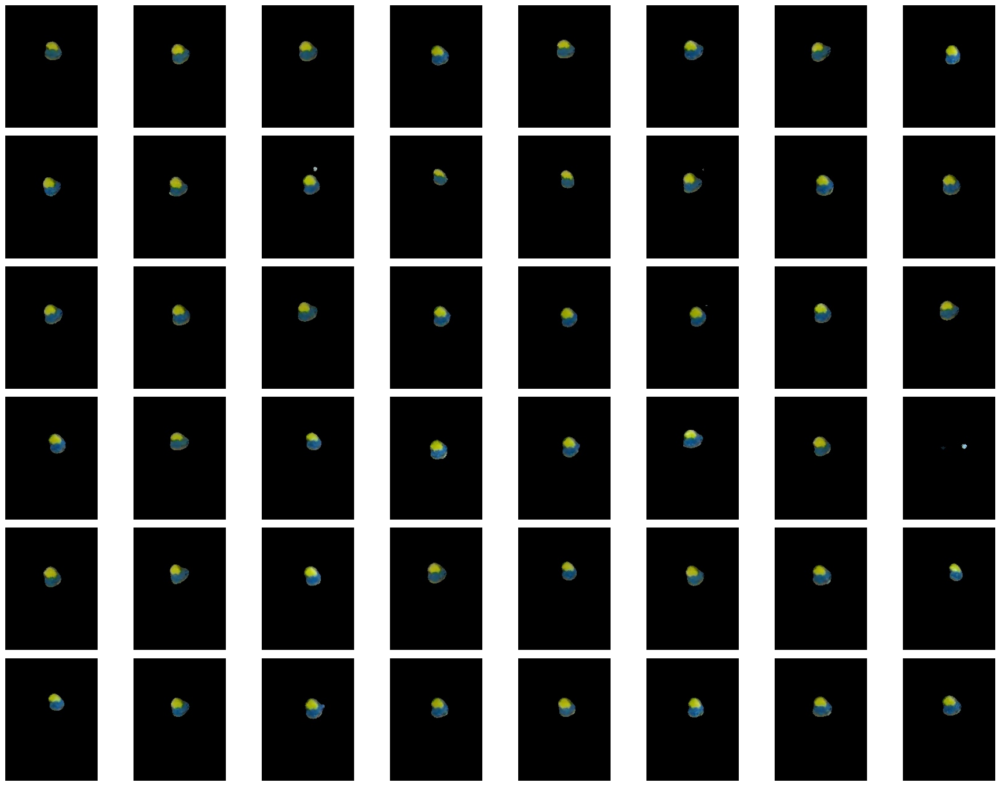

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1001GreenLlightBlue/


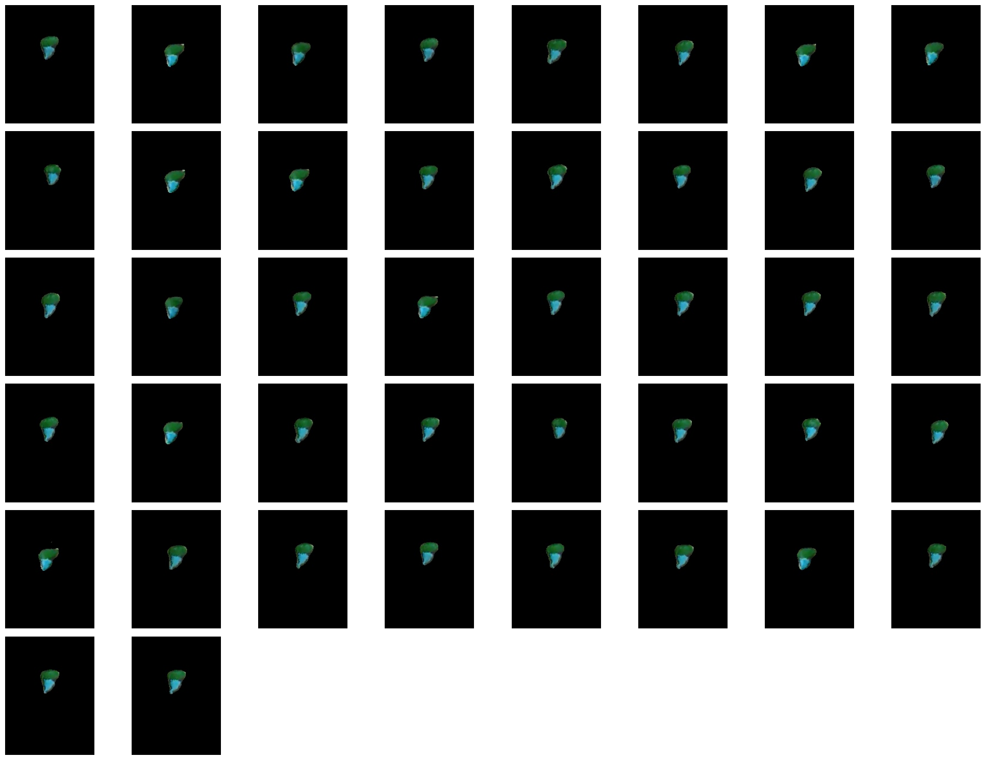

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1901YelloThor/


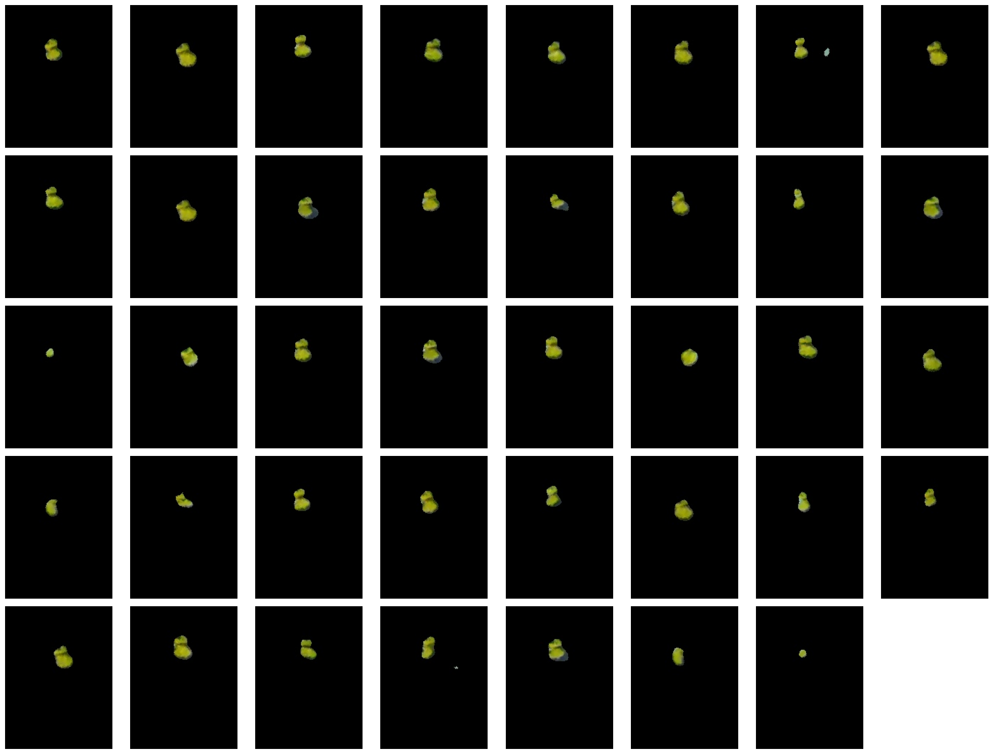

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1006GreenLightBluePink/


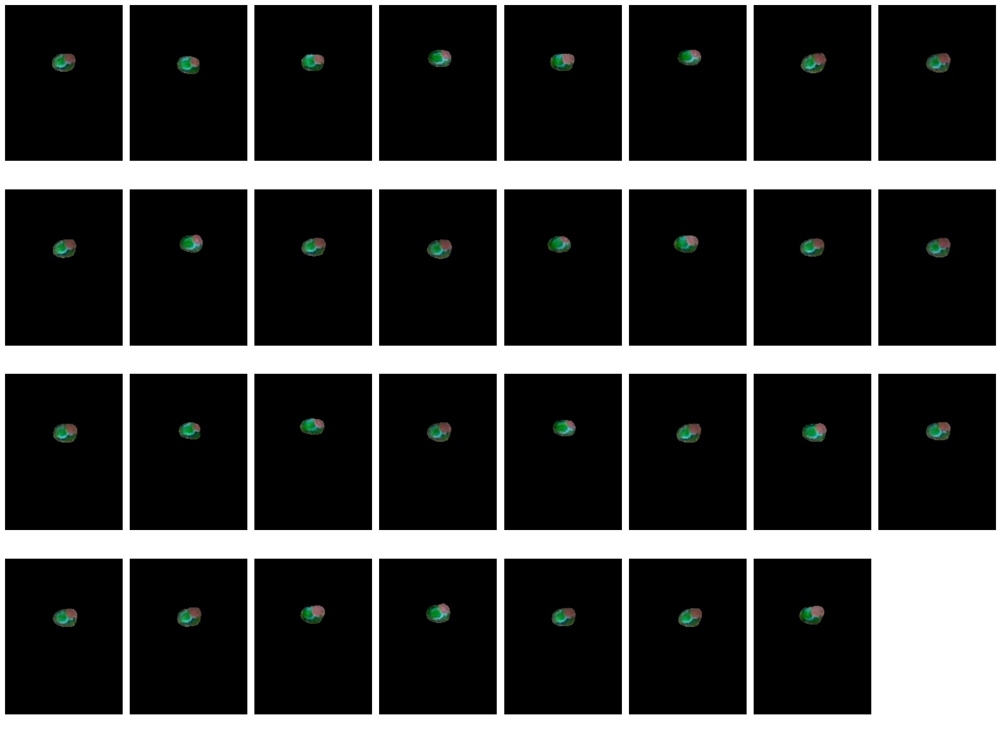

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1503RedGrey/


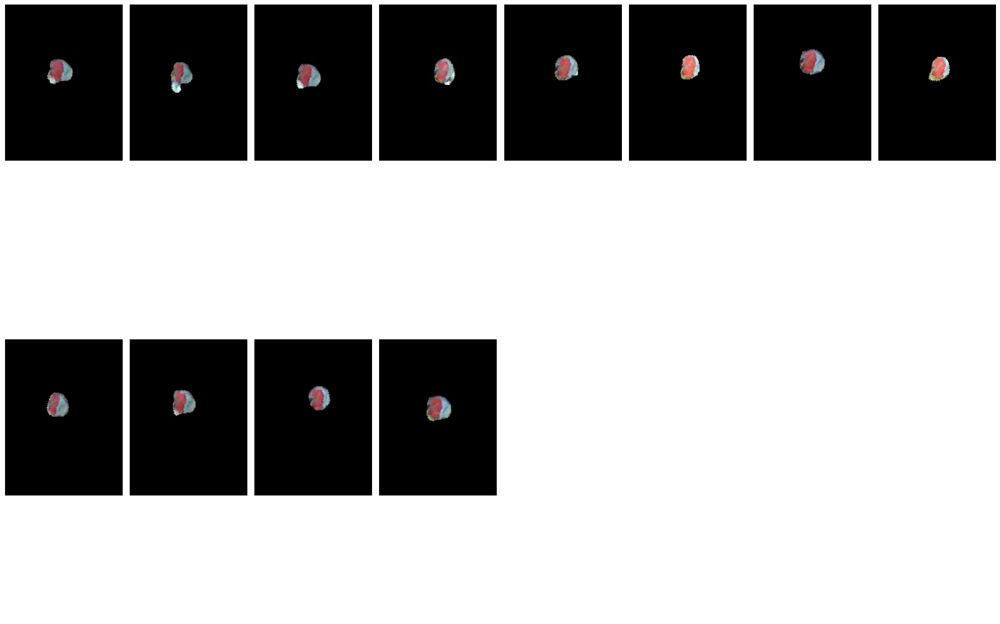

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0808Silver/


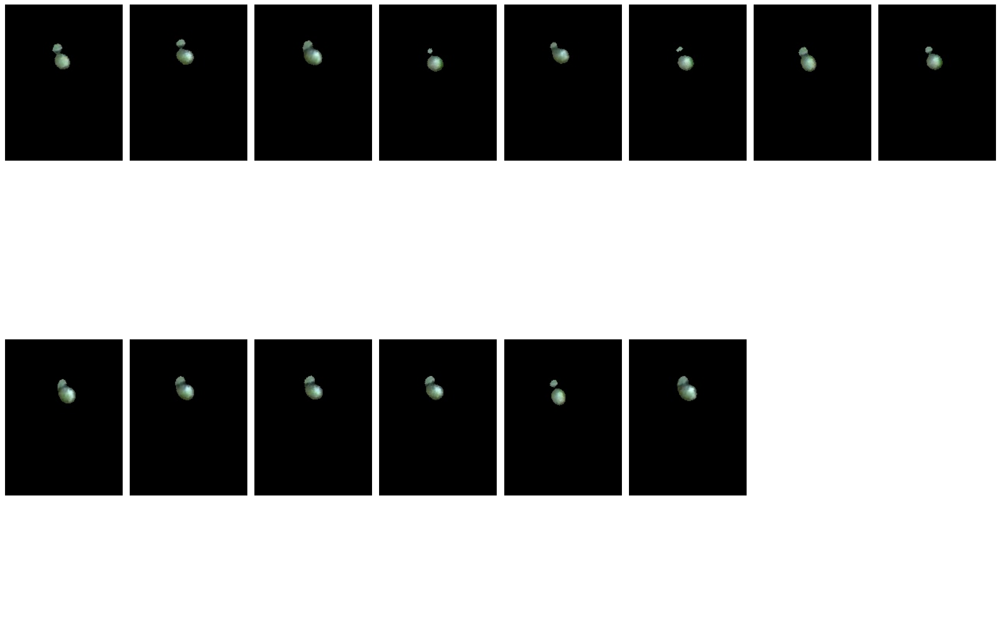

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0804GreenRed/


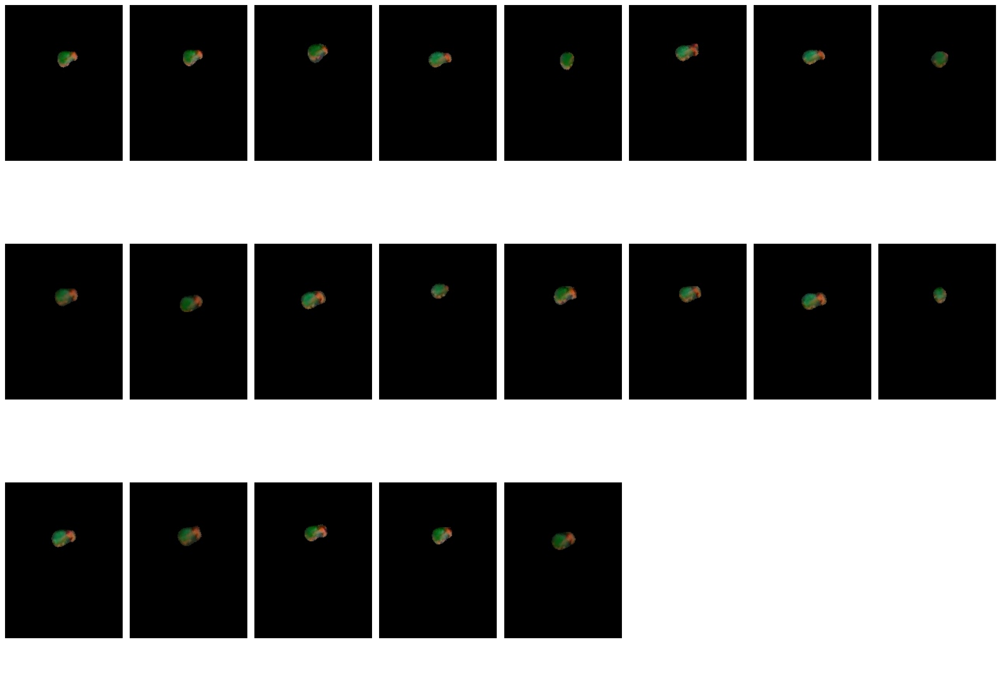

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2104BlueWhite/


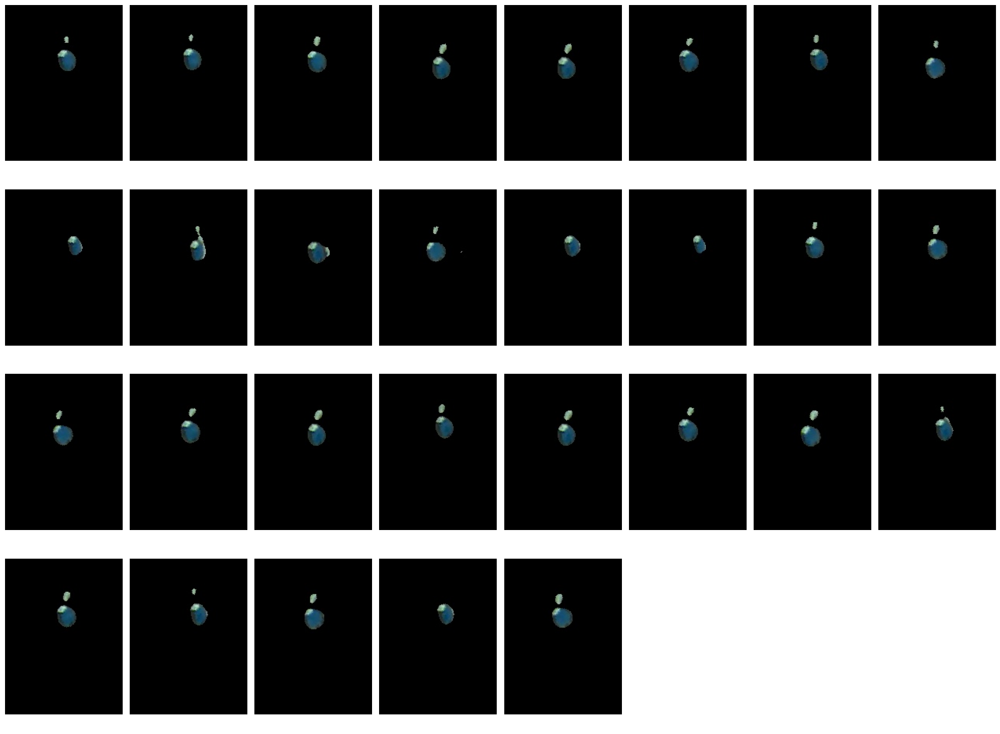

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0802YellowSilver/


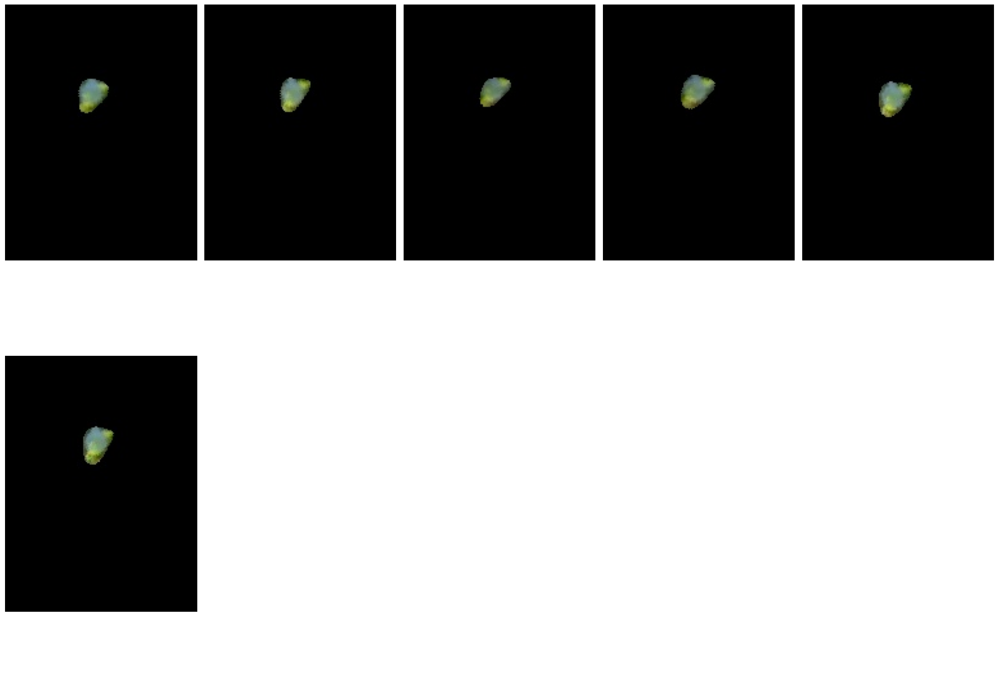

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1301Yellowbluehalfhalf/


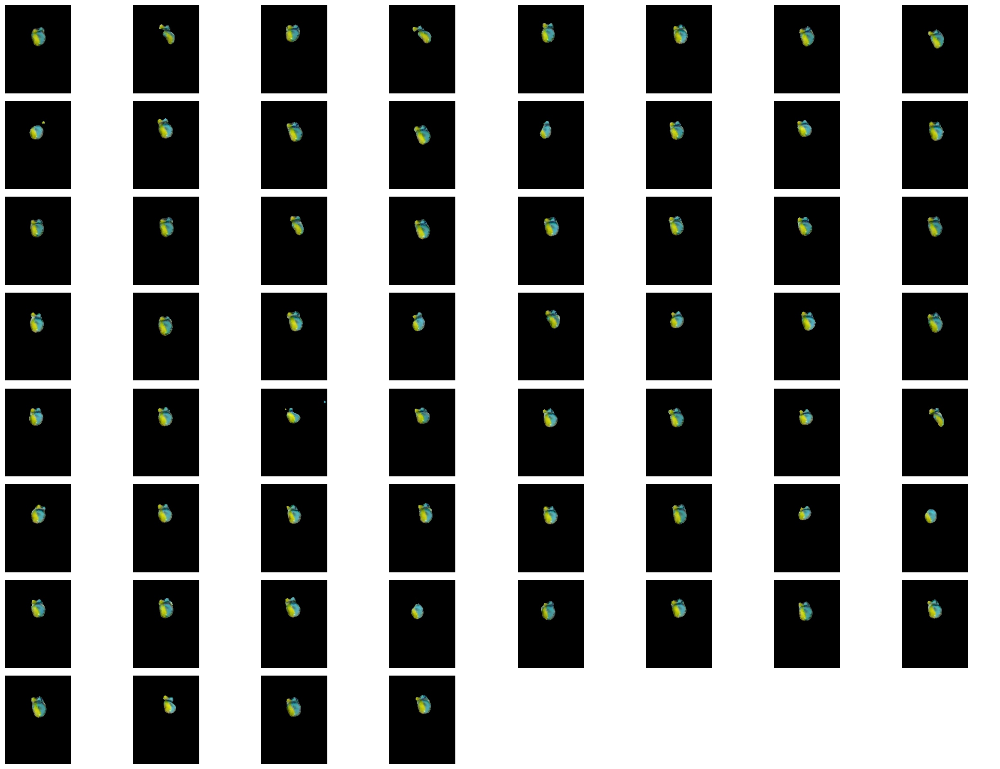

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1903YelloWhite/


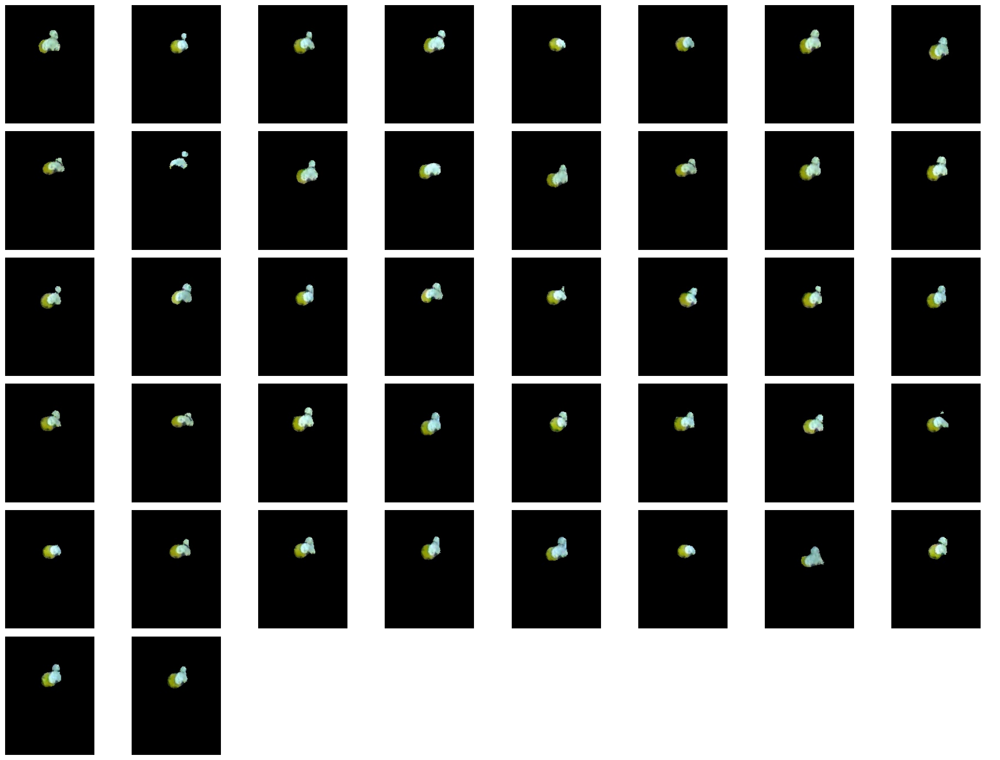

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1701GreenWhite/


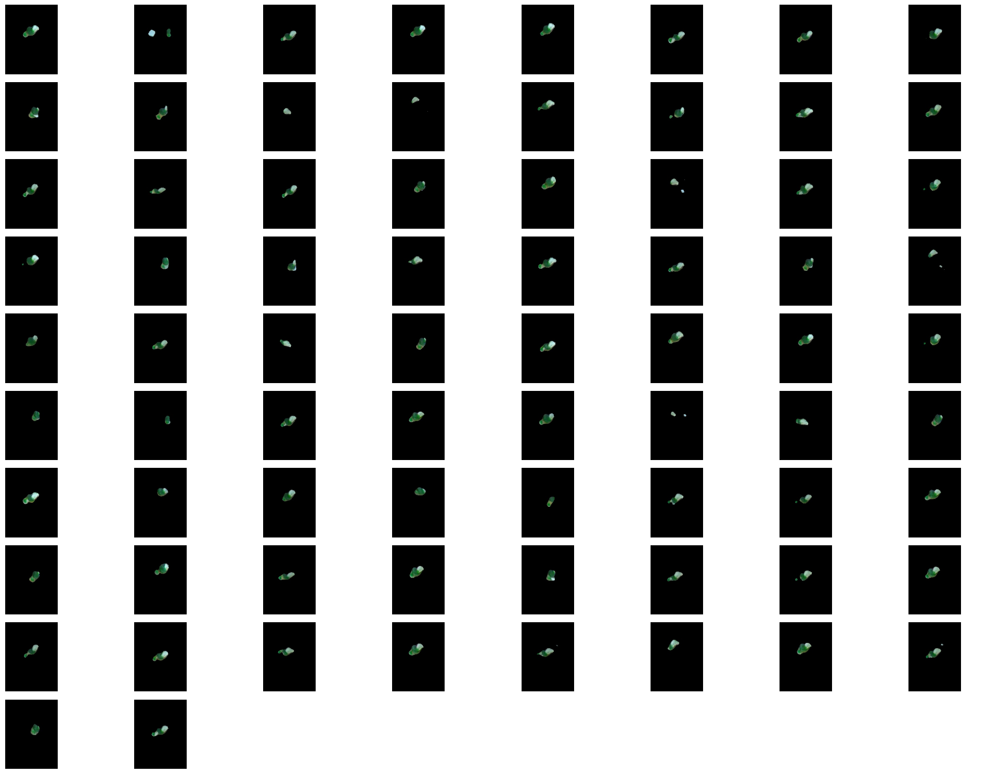

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0801Purple/


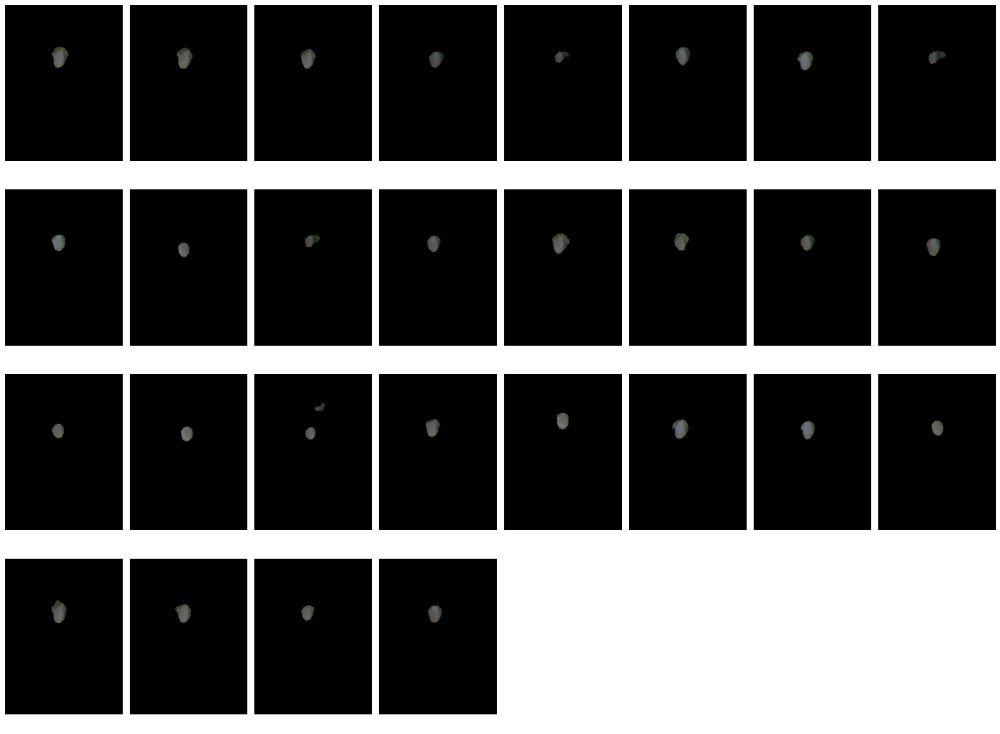

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1504WhiteGrey/


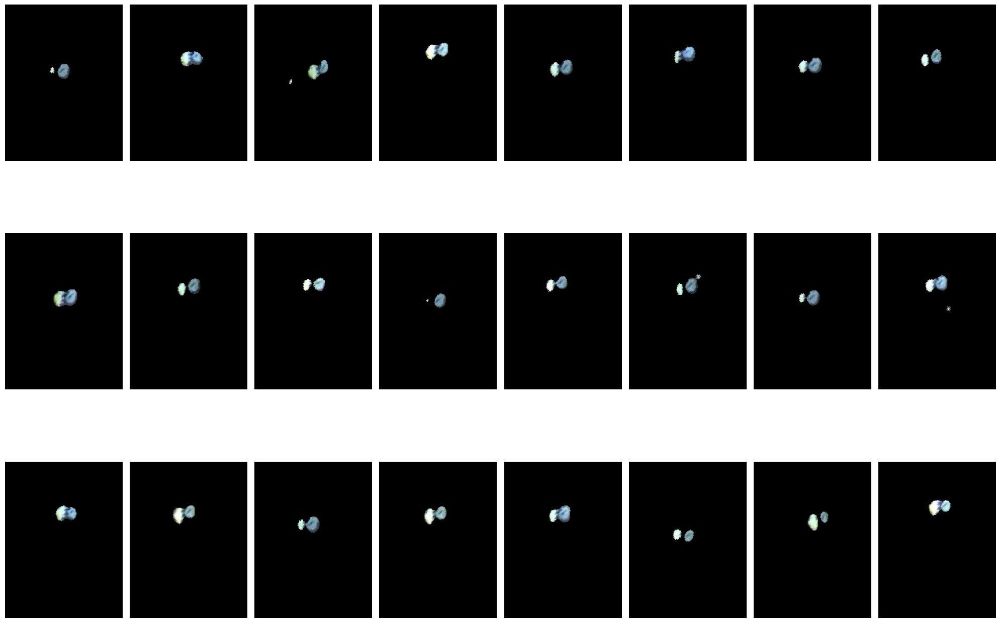

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0601BlueYellow/


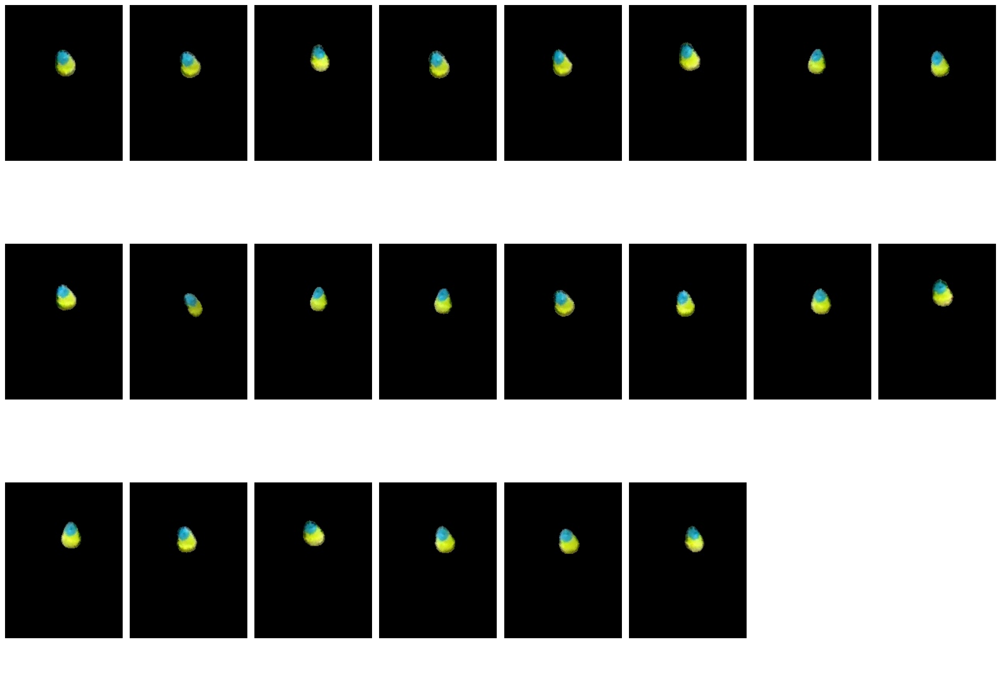

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0604Yellow/


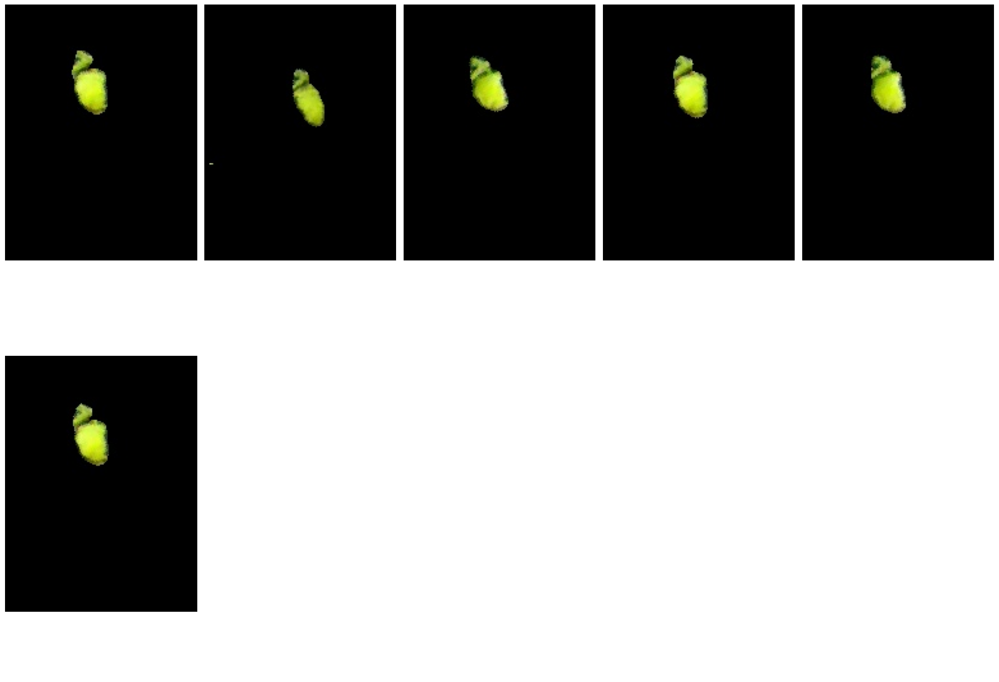

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0806PurpleYellowWing/


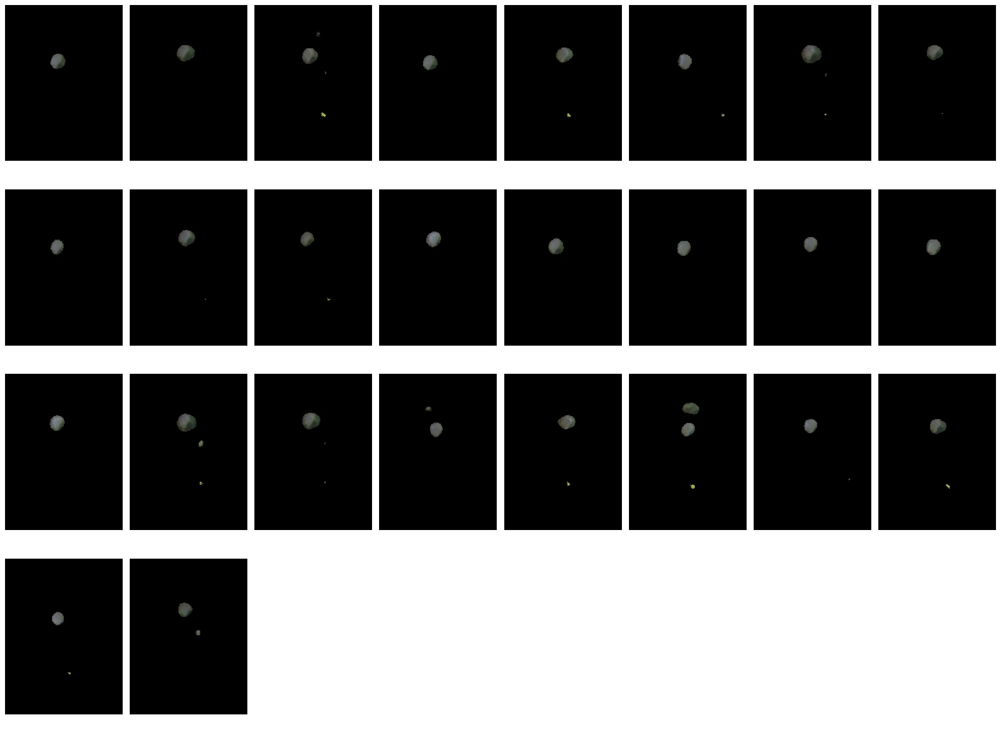

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0810PurpleRed/


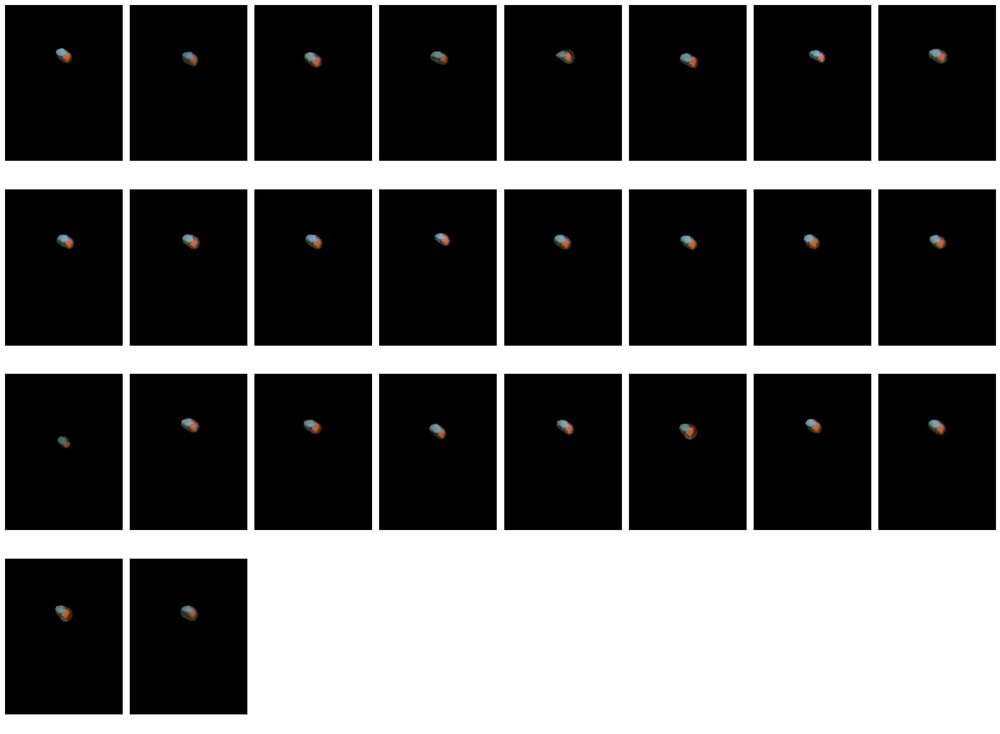

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0902GreenYellowHalfHalf/


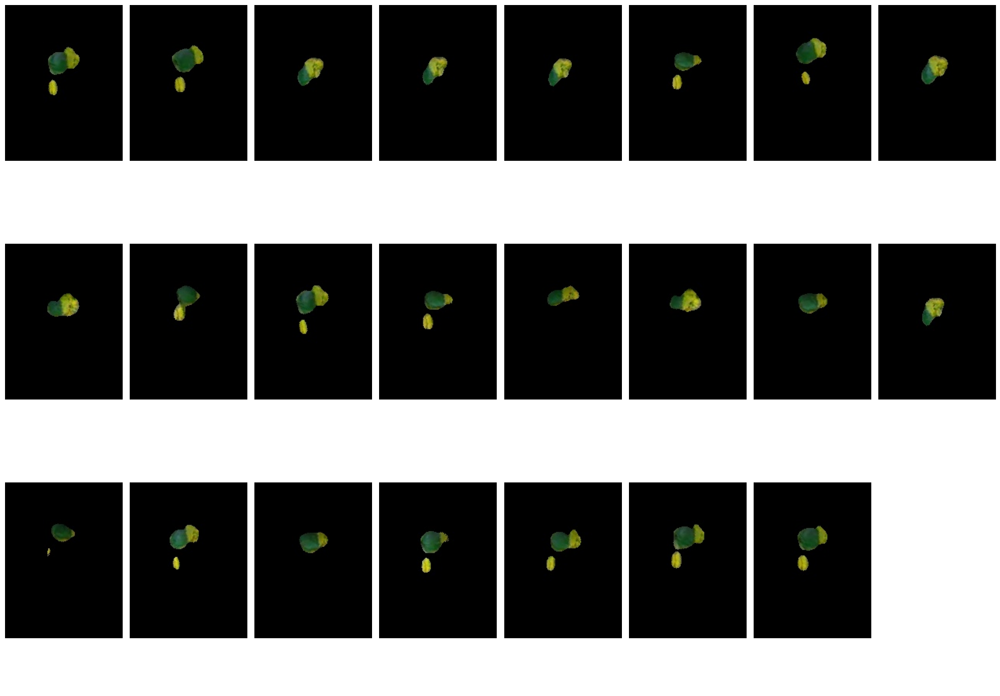

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2206GreenYello/


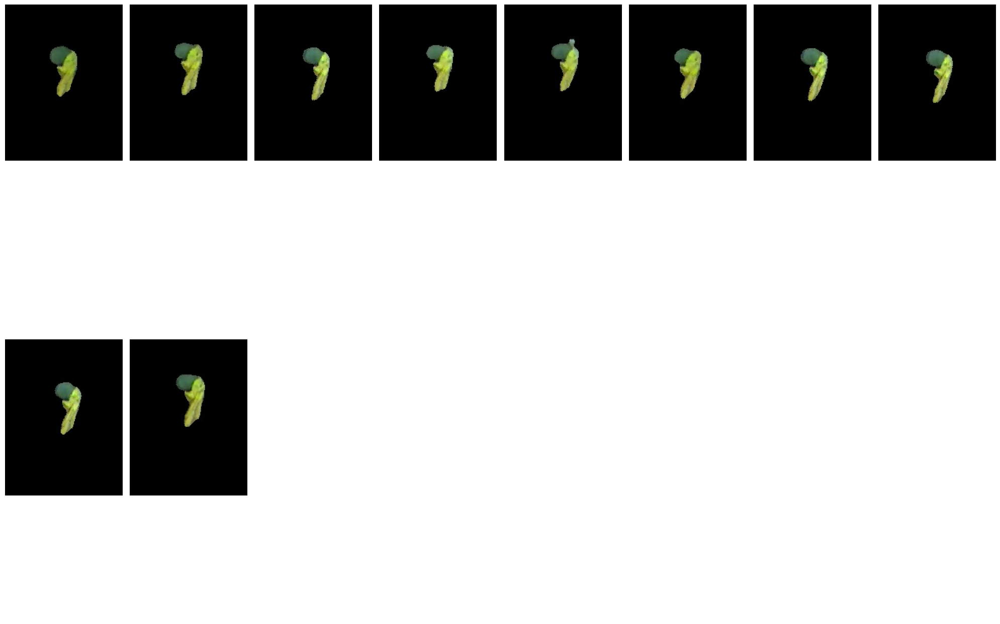

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1304WhiteBlue/


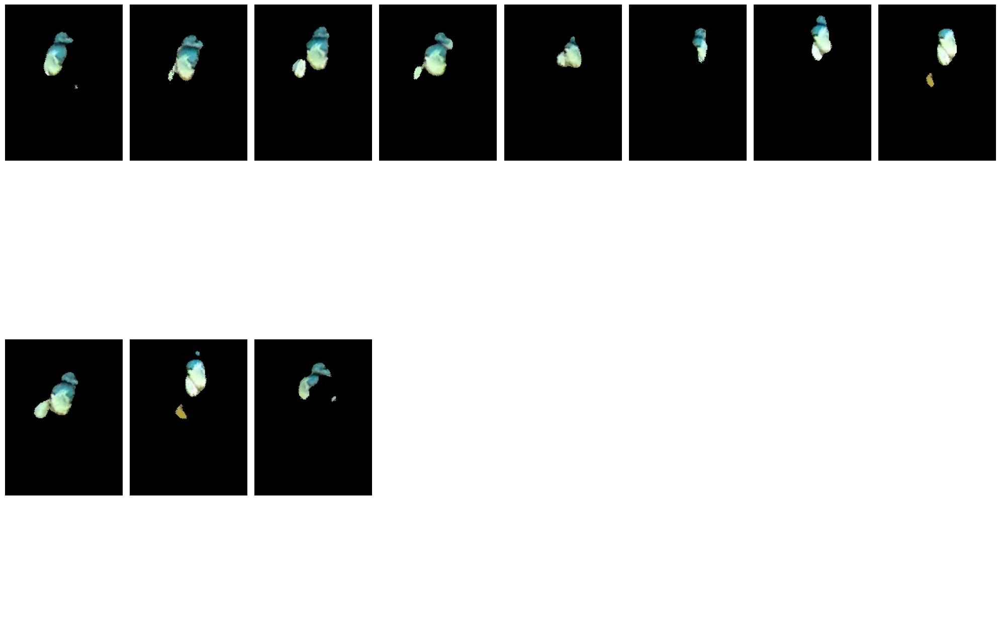

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1502YellowGreyDarkAb/


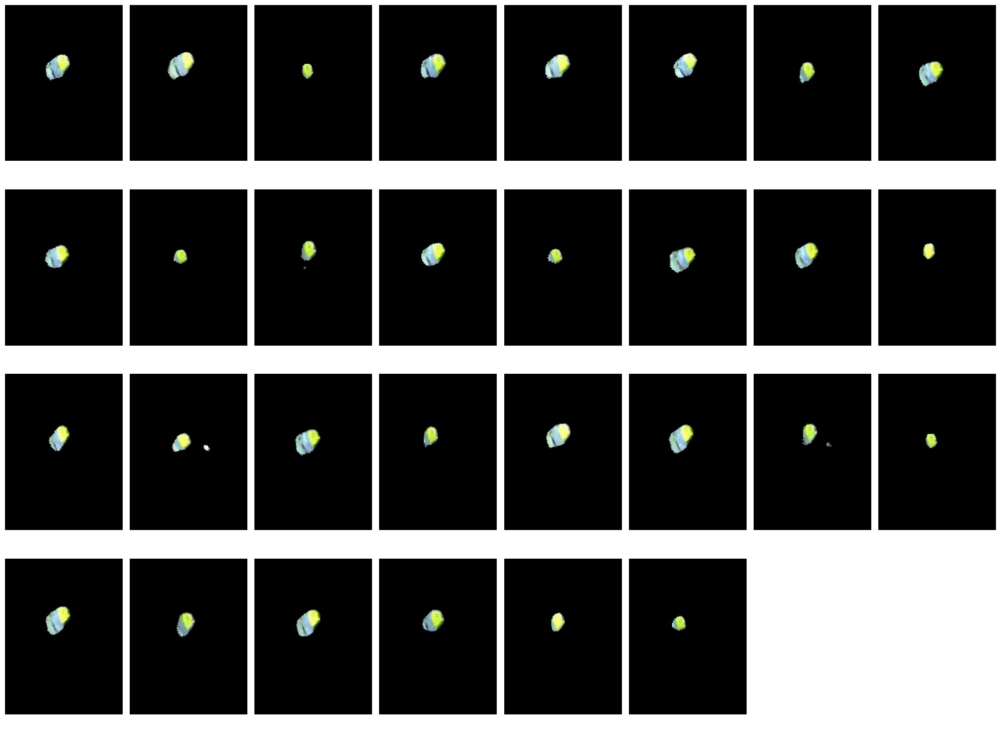

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1907YelloLightBlue/


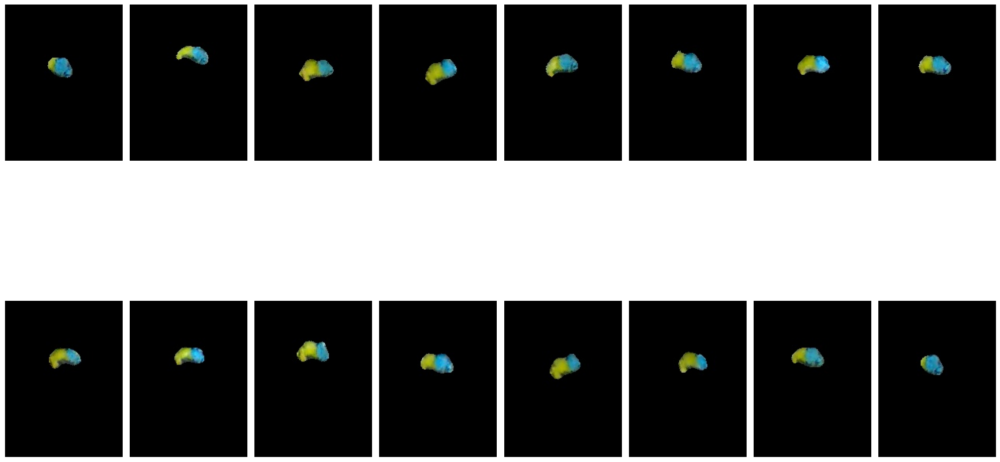

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2101BlueRed/


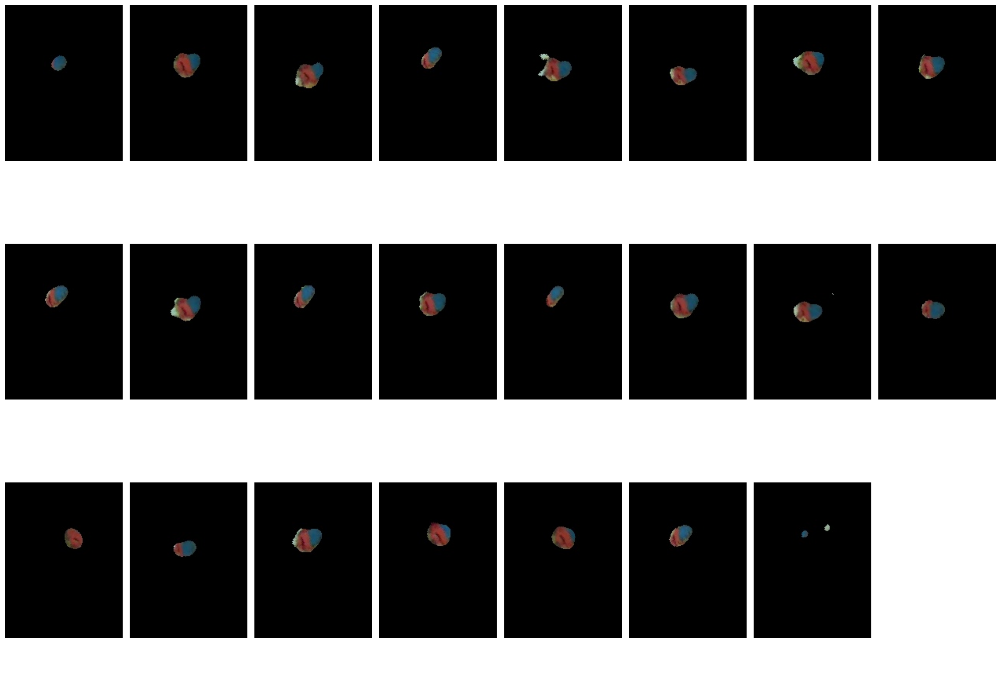

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1305PurpleLightBlue/


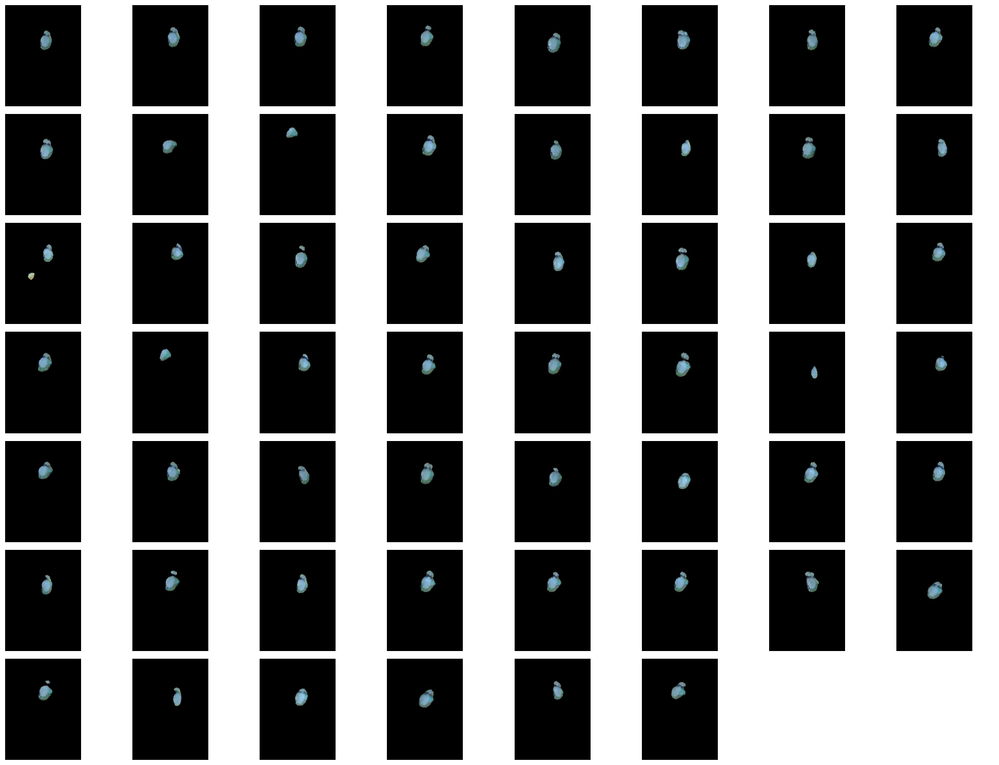

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1007GreenWhiteYelloWing/


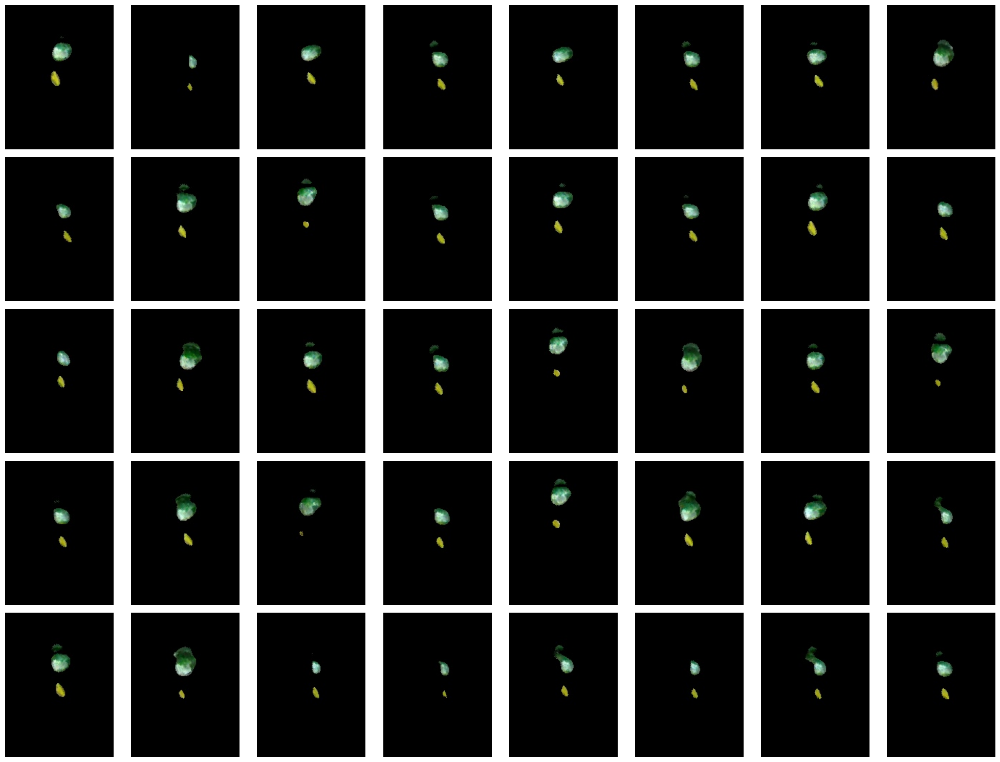

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0603YellowOrange/


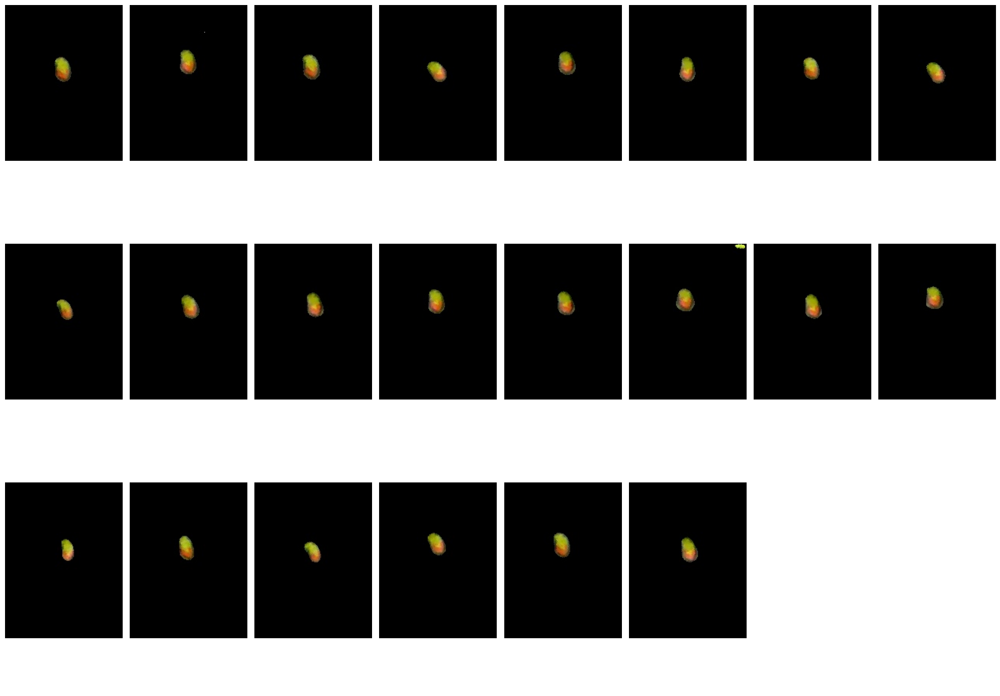

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0803RedLightBlue/


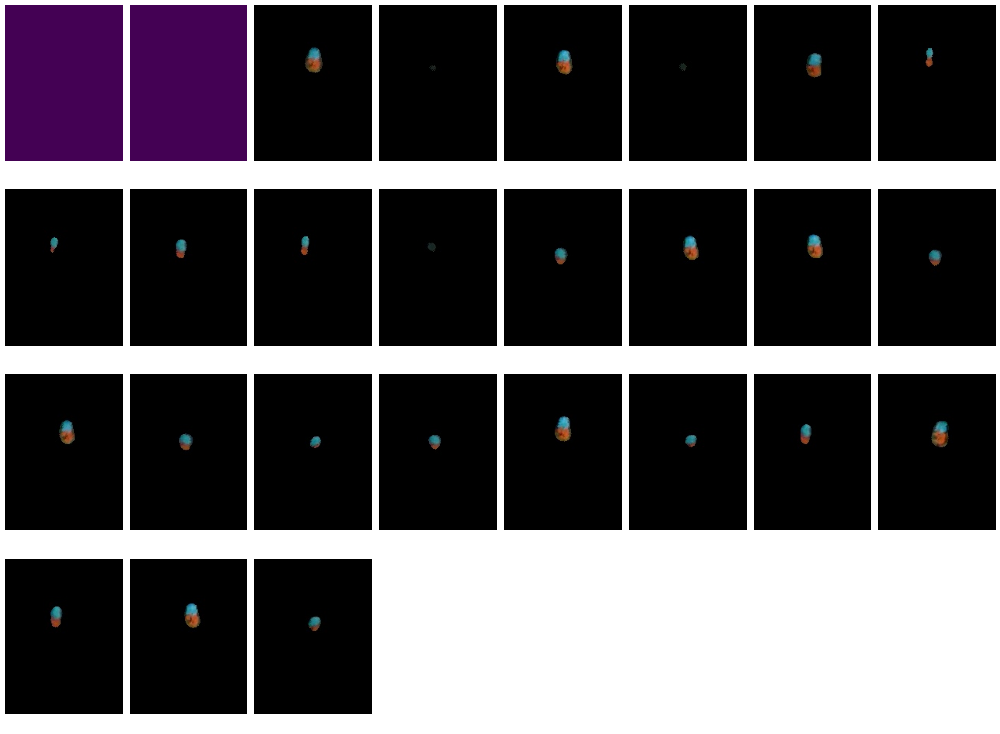

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1705YellowGrey/


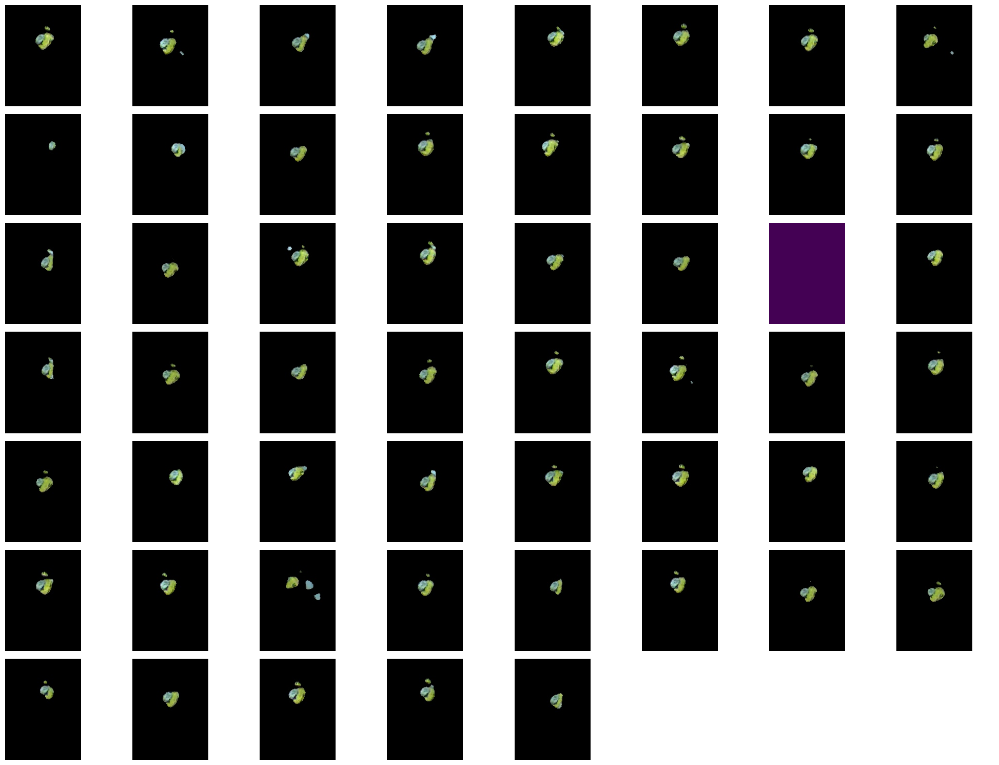

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1501YellowGrey/


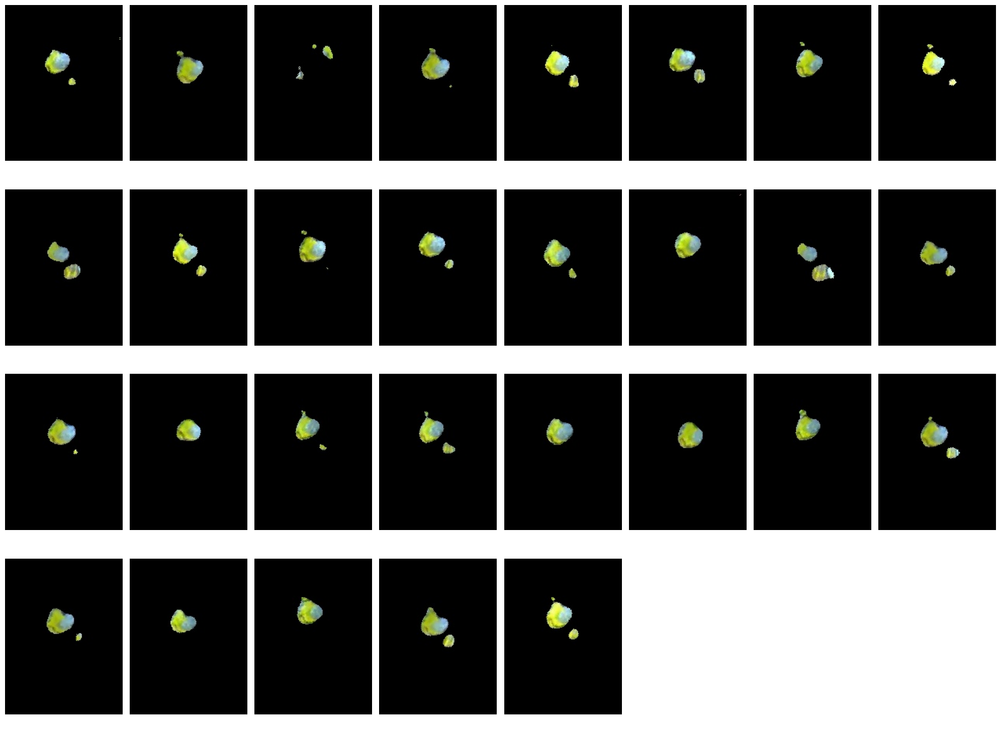

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1002PinkGreenWhite/


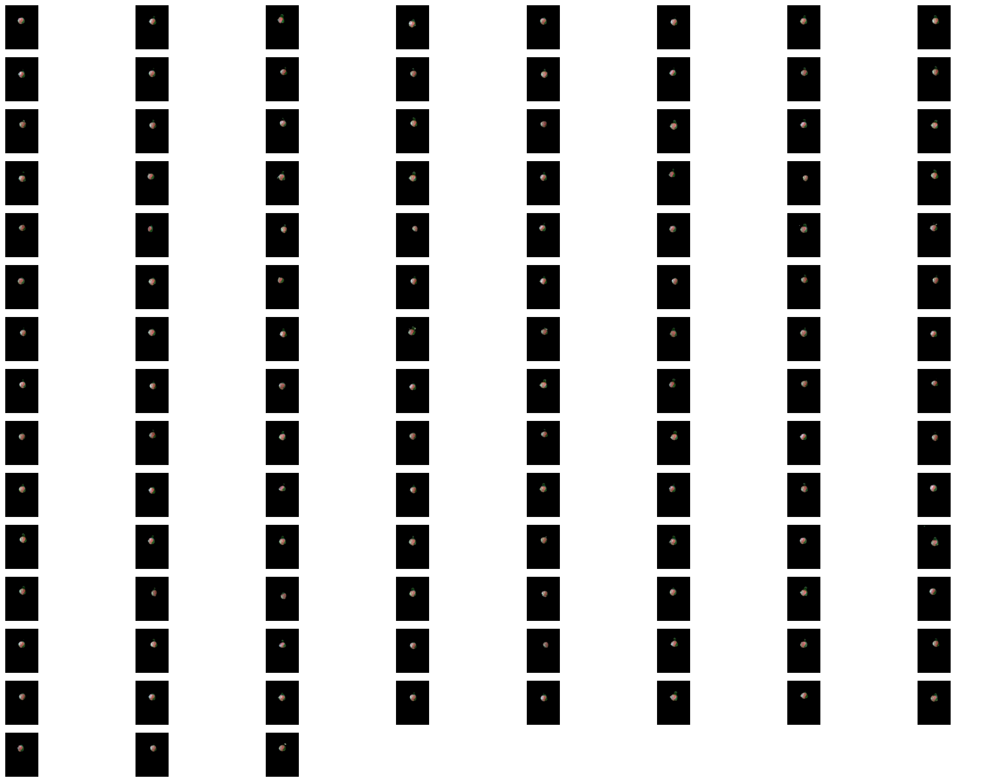

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1506Grey/


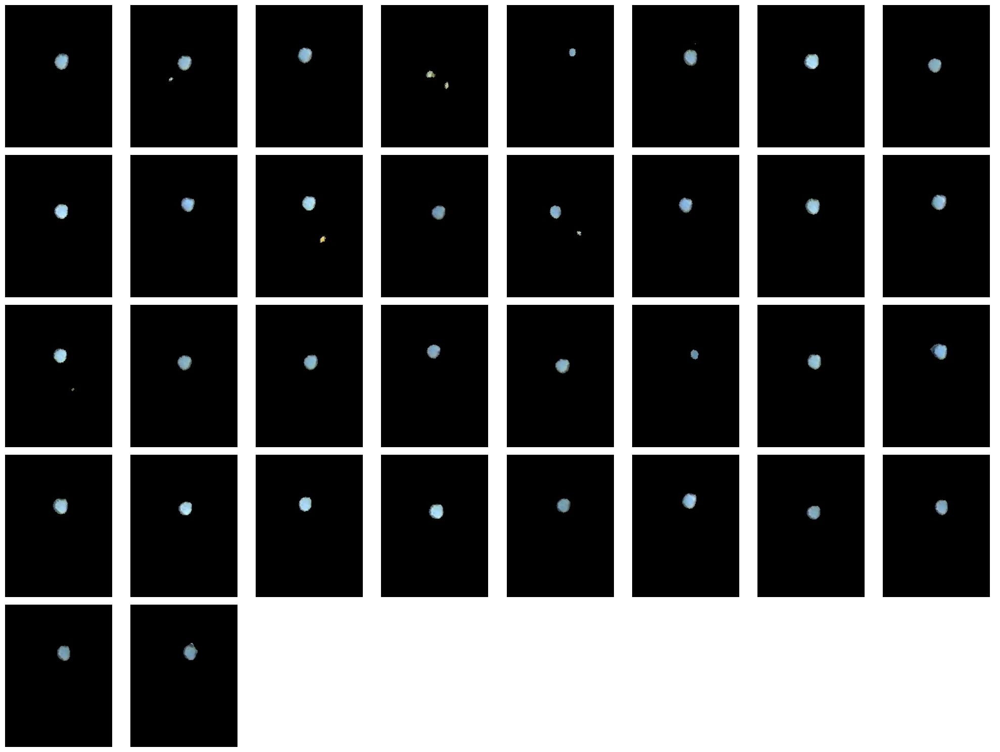

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0809RedSIlver/


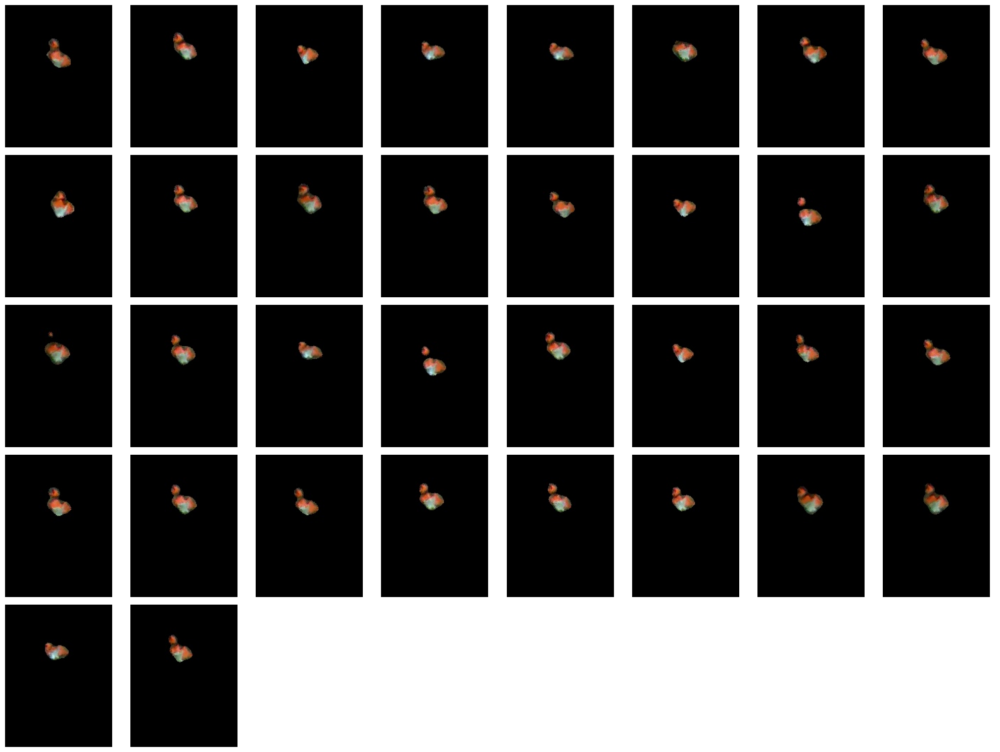

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0807GreenYellow/


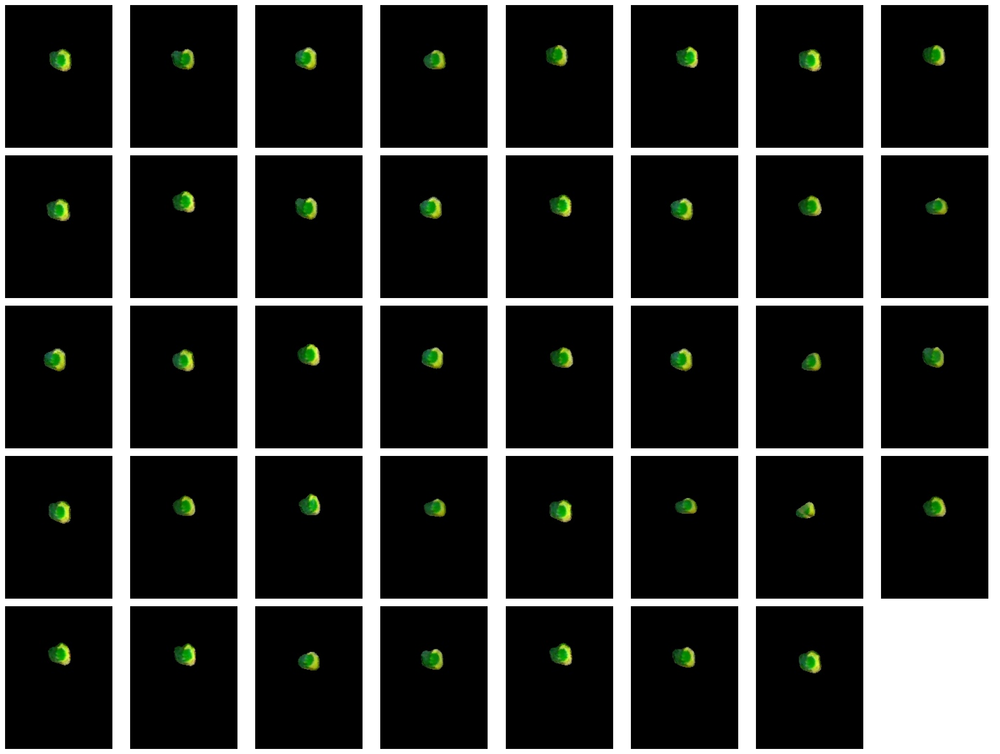

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0606PinkYellowBlend/


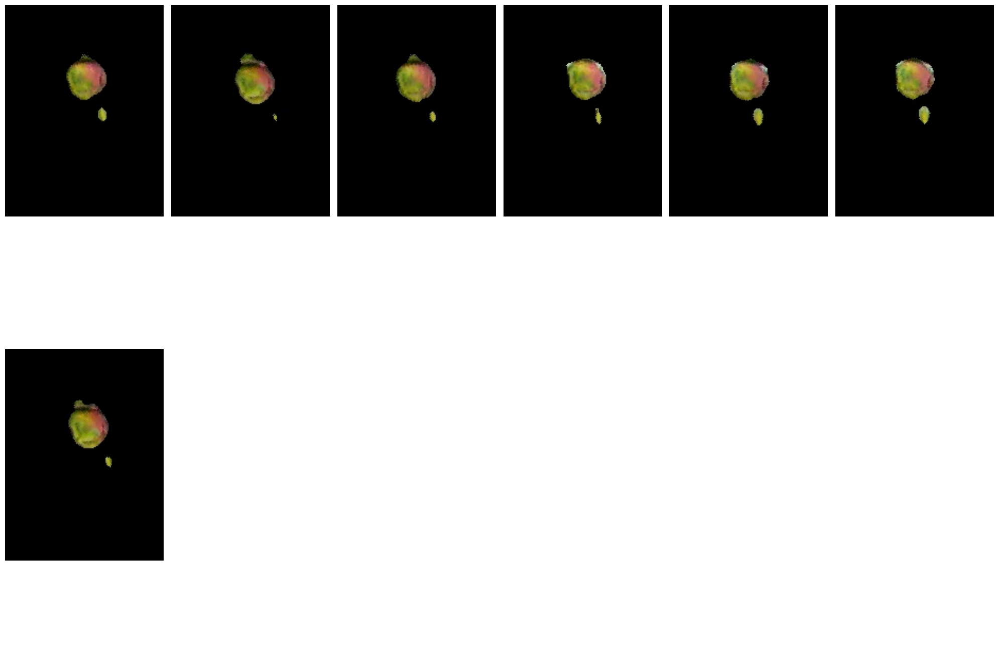

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2102BlueYellow/


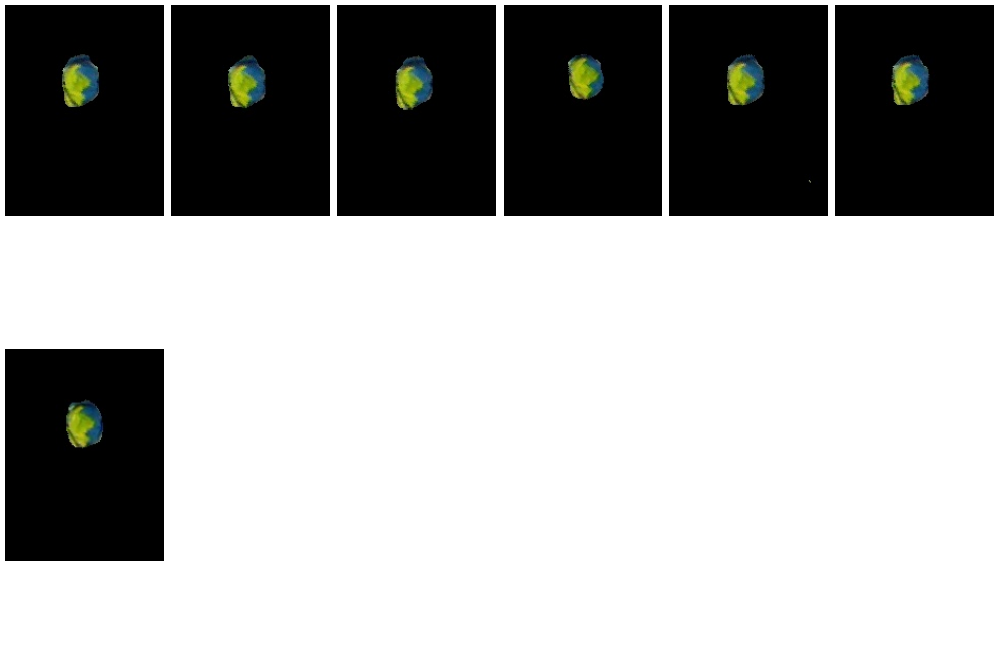

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2103GreenBlue/


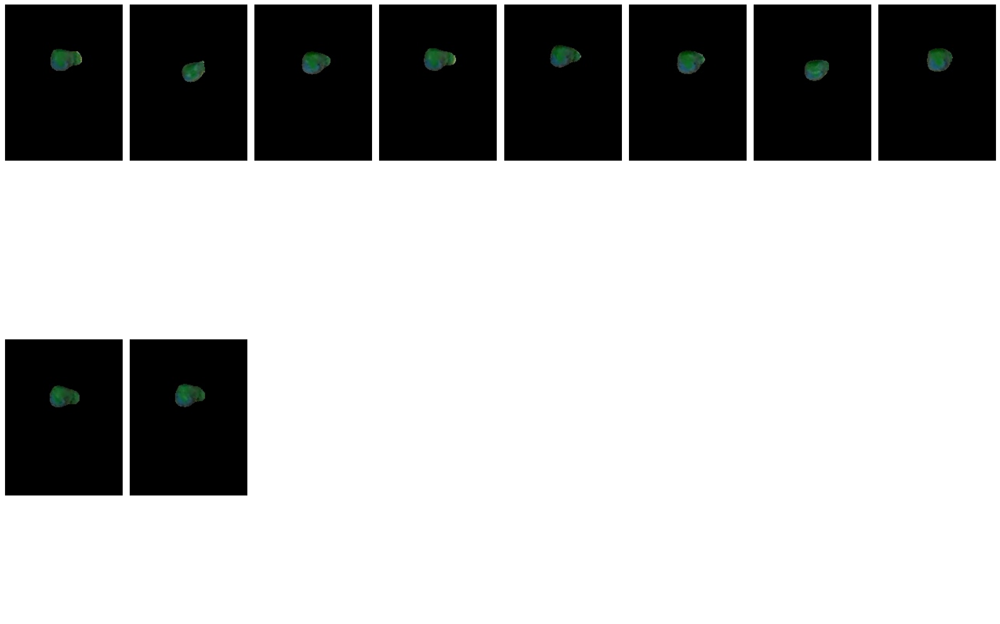

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1306YellowLightBlueSplotch/


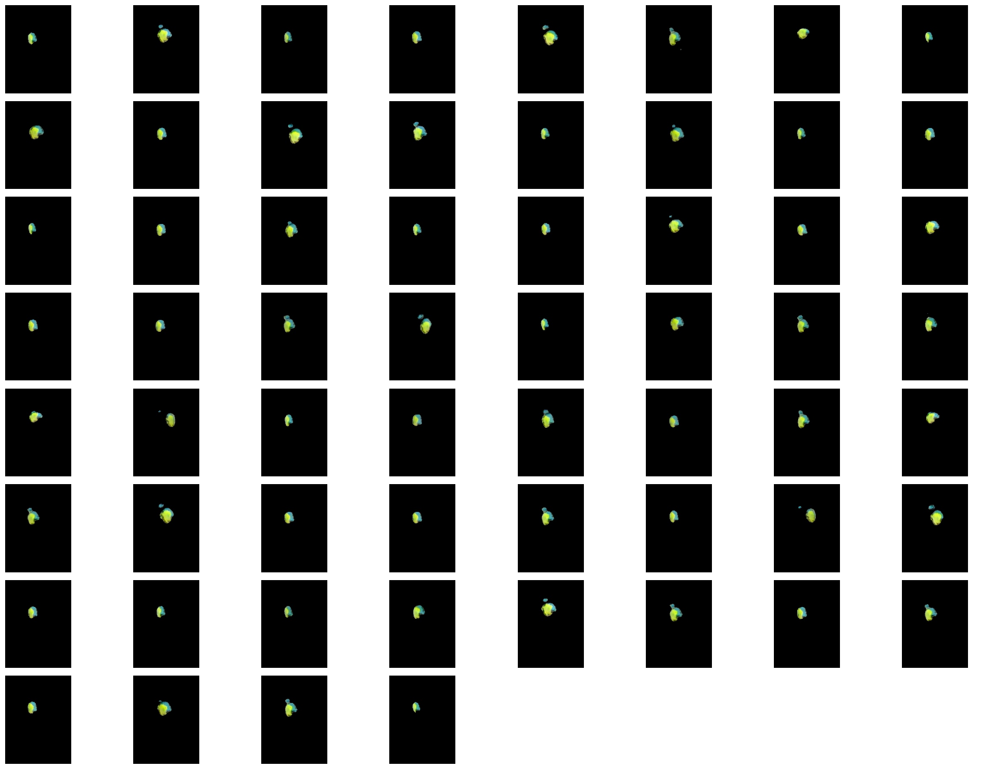

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1505GreyGreen/


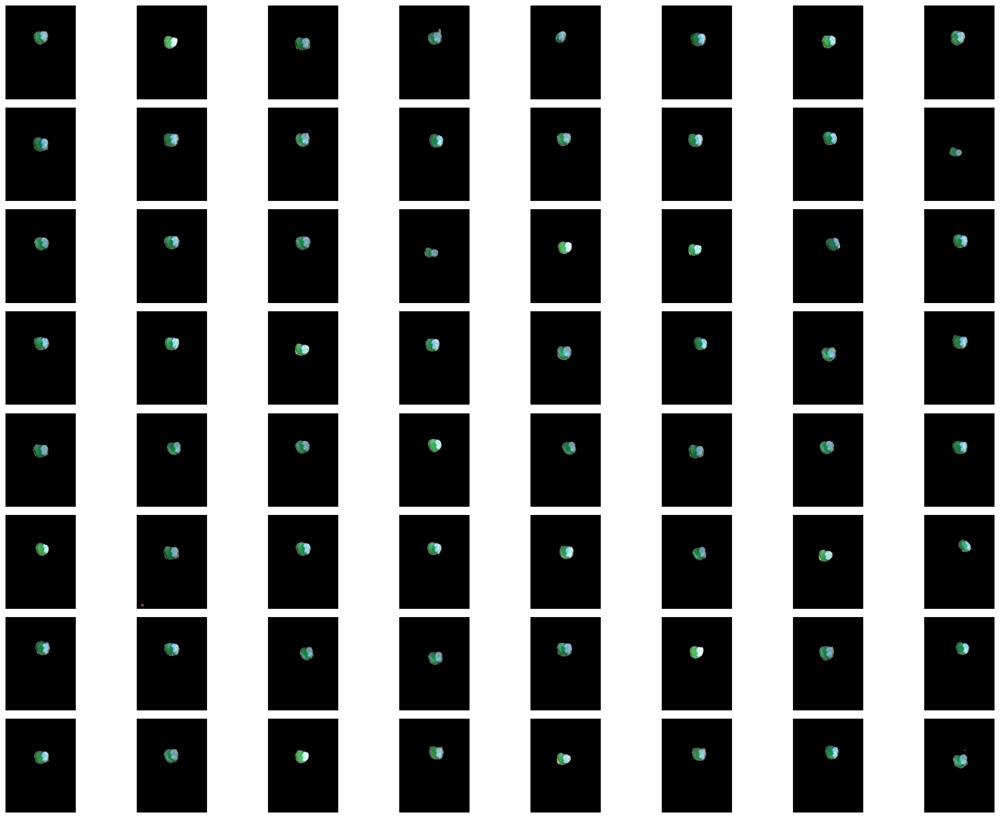

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2207RedGreen/


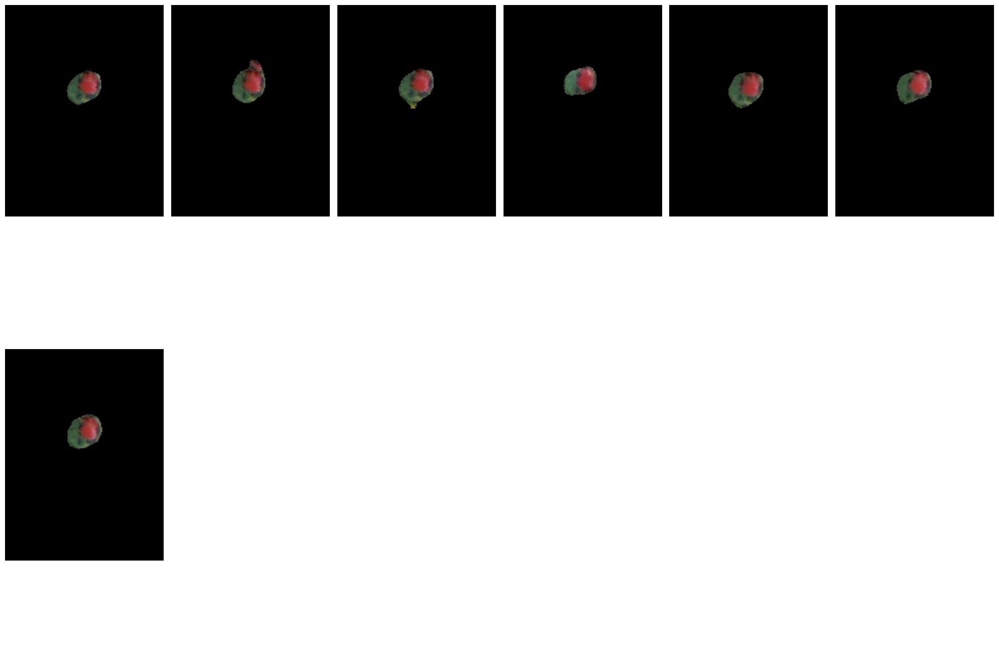

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1302RedLightBlue/


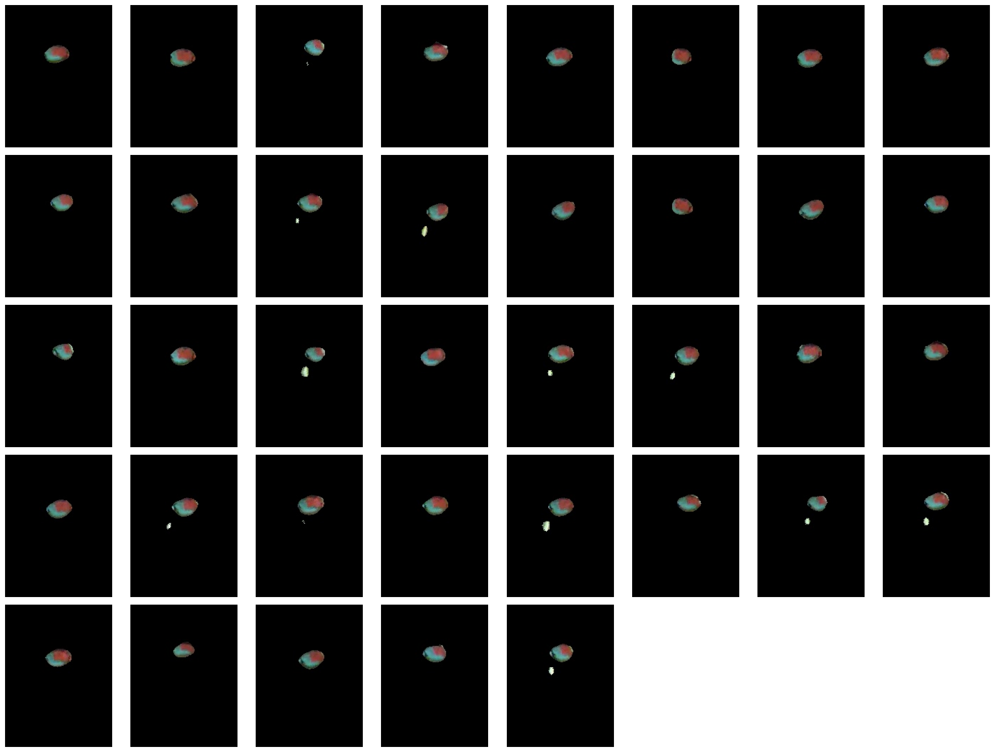

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1703WideSilver/


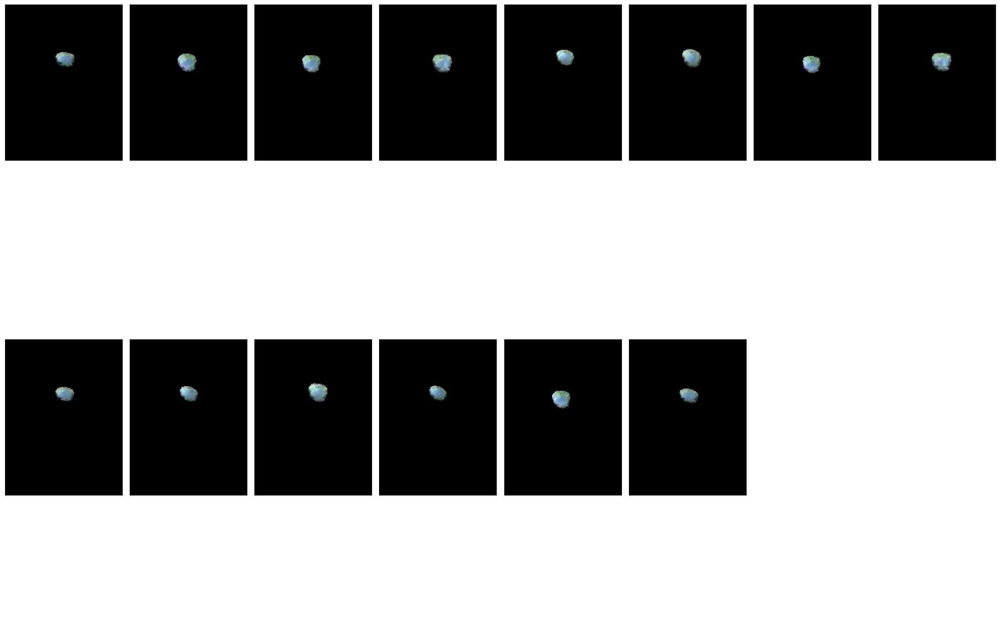

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1003GreenPurple/


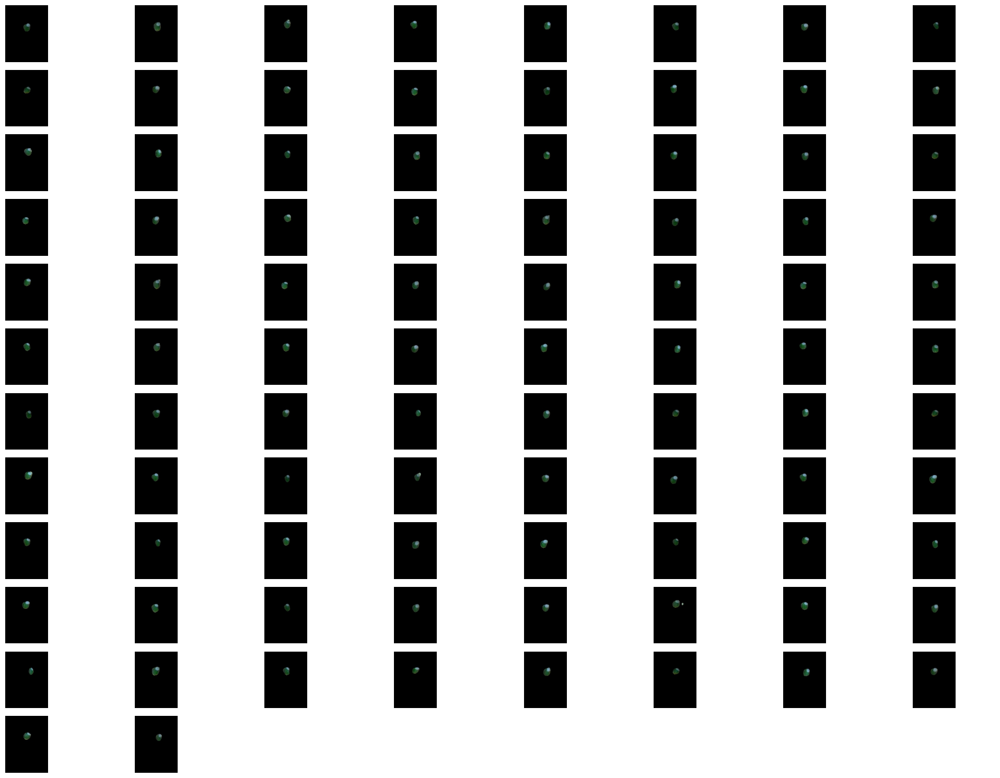

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1704White/


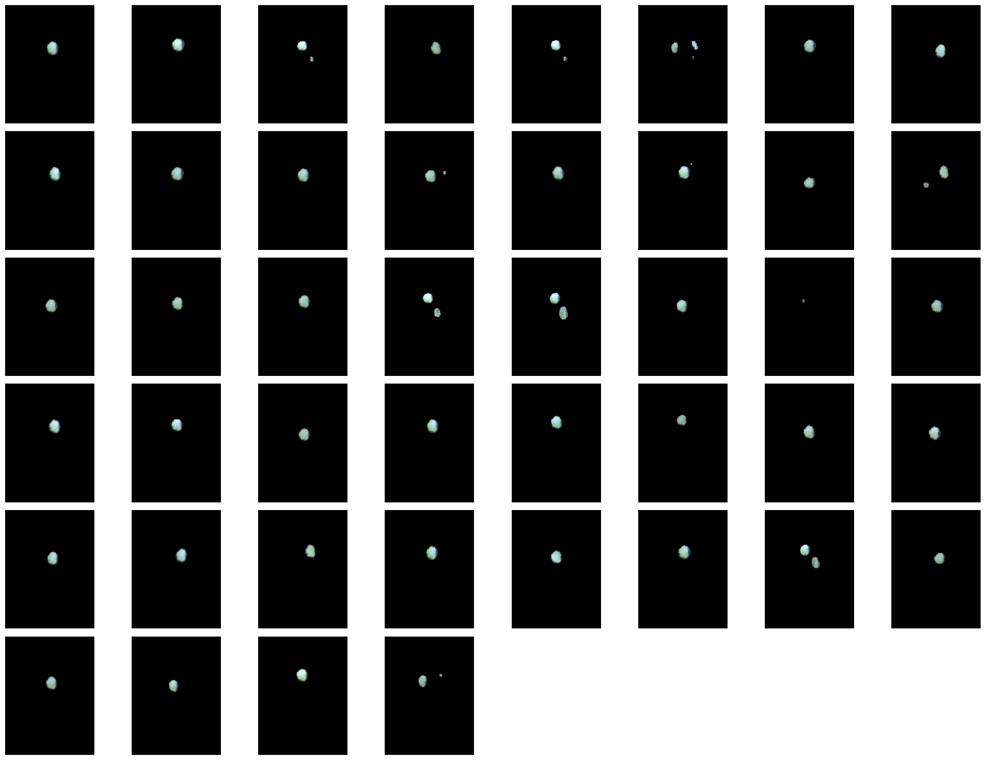

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0901GreenYellowCircle/


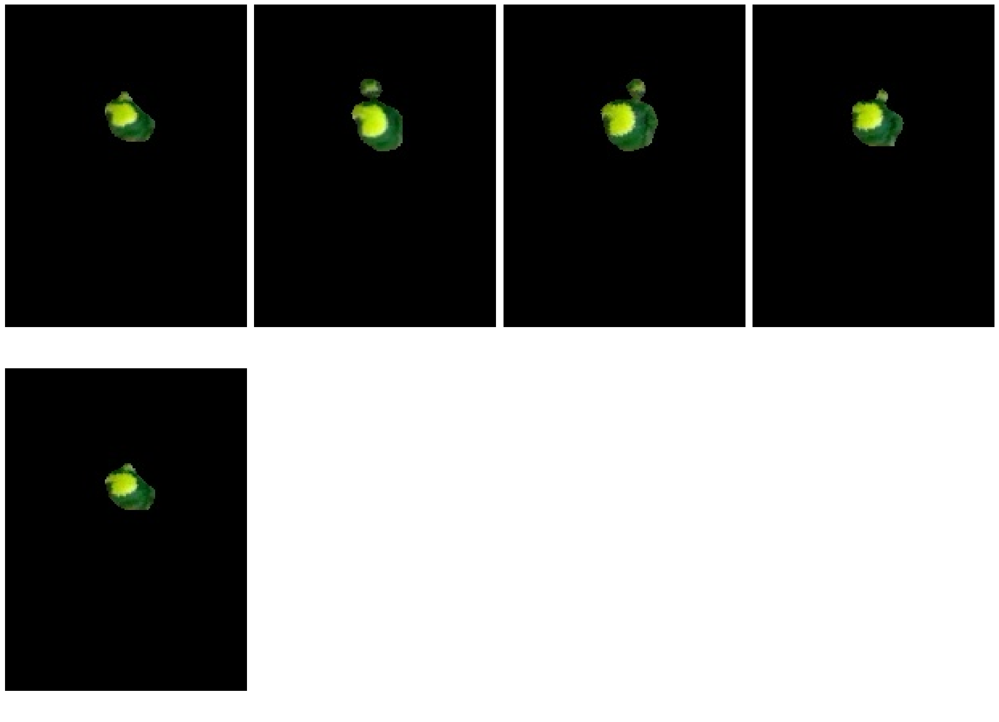

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1507GreyDotDarkAb/


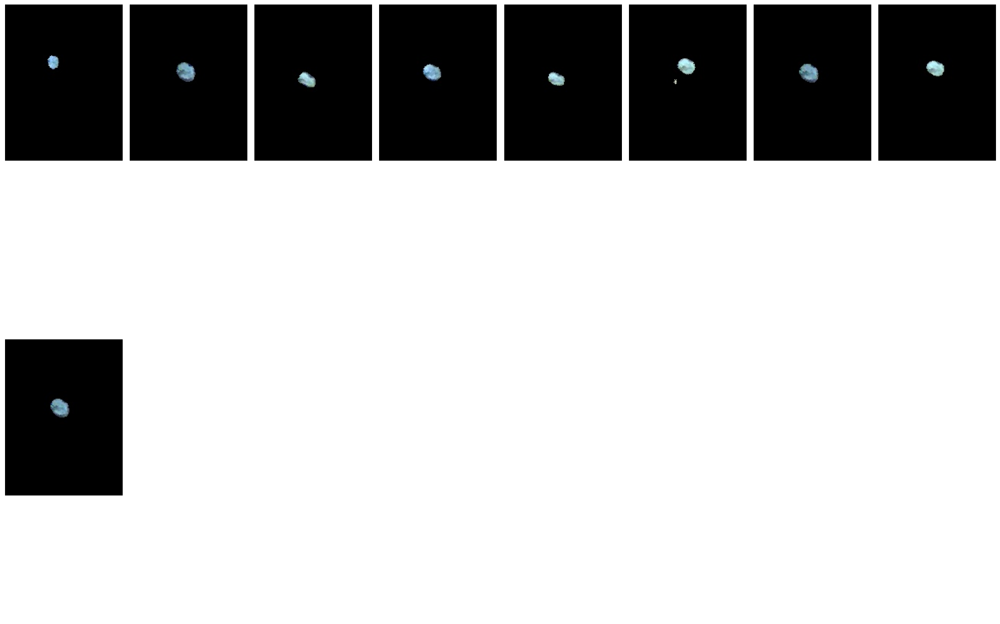

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1708BlueWhite/


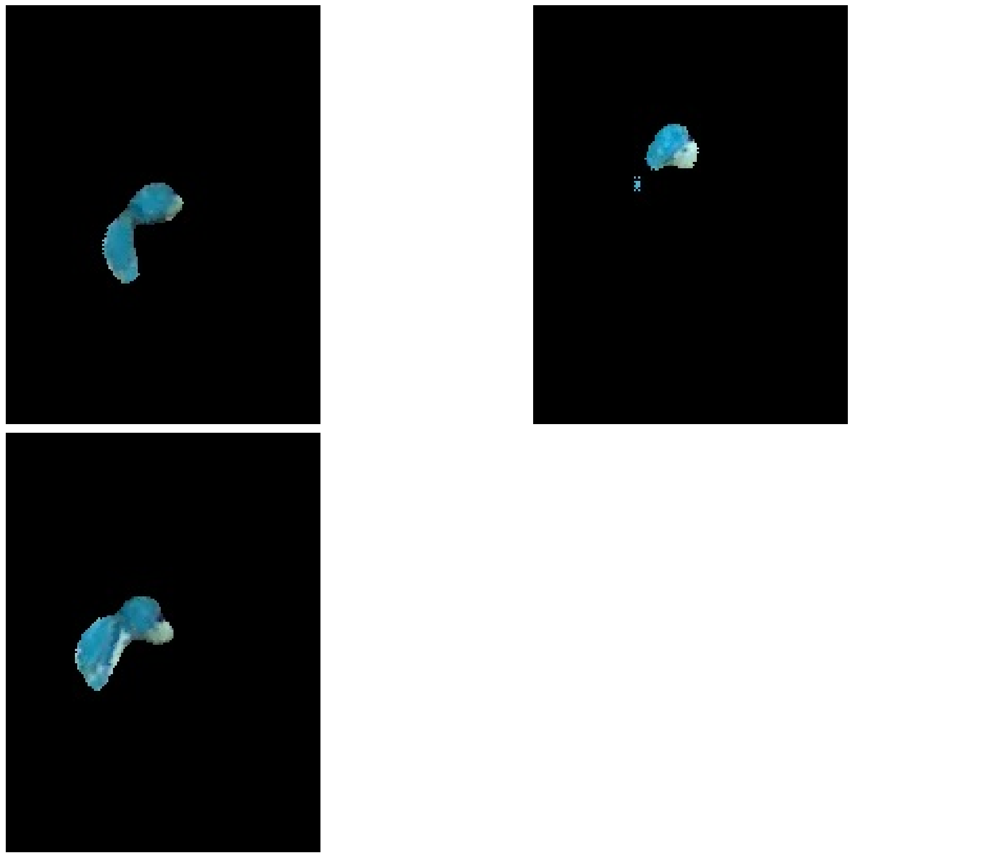

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#2205GreenWhite/


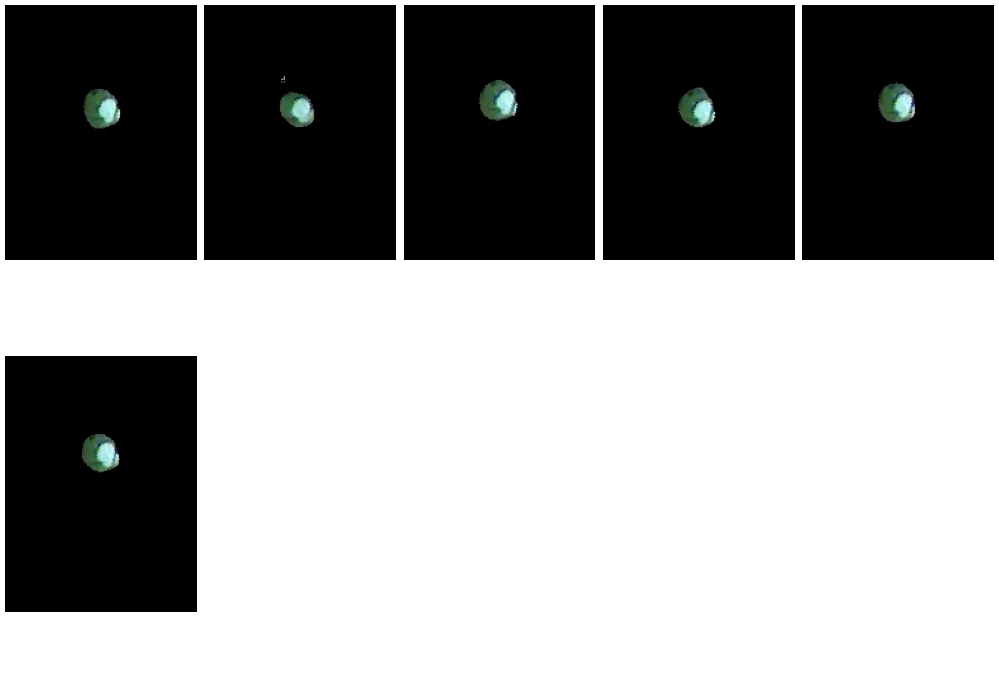

/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#1303BlueDotDarkAb/


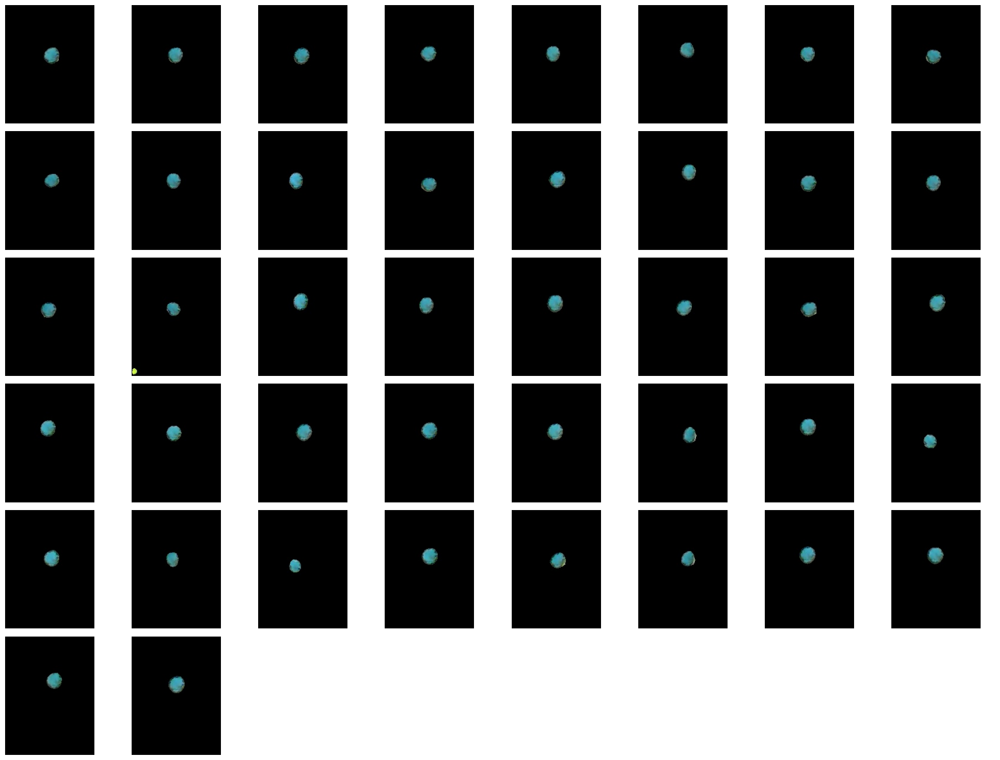

In [51]:
#check all folders to make sure there are none with no masks: 

import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def display_images_in_folder(folder_path, num_cols=8):
    # Get a list of image files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith('.jpg') or f.endswith('.png')]
    
    # Calculate the number of rows needed based on the number of columns specified
    num_rows = (len(image_files) - 1) // num_cols + 1
    
    # Create a new figure
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 15))
    
    # Loop through the image files and display each image
    for i, image_file in enumerate(image_files):
        row = i // num_cols
        col = i % num_cols
        
        image_path = os.path.join(folder_path, image_file)
        img = mpimg.imread(image_path)
        axes[row, col].imshow(img)
        axes[row, col].axis('off')
    
    # Remove any empty subplots
    for i in range(len(image_files), num_rows*num_cols):
        row = i // num_cols
        col = i % num_cols
        axes[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()

# Example usage
folder_path = '/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/'
walk = os.walk(folder_path)
i = 0 
for root, dir, files in walk:
    if i != 0: 
        print(root+r'/')
        if len(files) < 8: 
            display_images_in_folder(root+r'/',(len(files)-1))
        else:
            display_images_in_folder(root+r'/')
    i +=1 


In [16]:
# Read and correct problematic files, replace one channel negative images with 3 image negative channels

import cv2 
from PIL import Image
import matplotlib.pyplot as plt


walk2 = os.walk('/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0803RedLightBlue/')

fi = []
for root, dir, files in walk2:
    for f in files:
        fi.append(root+f)

for f in fi:
   
    img = Image.open(f)
    print(type(np.array(img)))
    plt.imshow(img)
    plt.show()
    
#img = cv2.imread('/home/lmeyers/SLEAP_files/Bee_imgs/baby_bee_imgs/Multicolor/Masks/ID#0803RedLightBlue/f08x2022_06_28.mp4.track000044.frame000676.paint_mask.jpg')
#print(img[0])


TypeError: 'tuple' object is not callable